# CV - Project 1 Super-Resolution

## Imports

In [1]:
import numpy as np 
import pandas as pd 
import os
import re
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, Dropout, Conv2DTranspose, UpSampling2D, add, Flatten, Lambda, Reshape, BatchNormalization, concatenate, AveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras import regularizers
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.python.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, TensorBoard
import matplotlib.pyplot as plt
import scipy
from PIL import Image
import random
import cv2
from tensorflow.keras.metrics import MeanAbsoluteError, MeanSquaredError, RootMeanSquaredError, Mean, binary_crossentropy, binary_accuracy
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import time

#### Constants

In [2]:
INPUT_SHAPE = (400, 600, 3)
IMAGE_SHAPE = (400, 600)
# BATCH_SIZE = 4 # for inception-like models
BATCH_SIZE = 8 
EPOCHS = 100
seed = 42

### GPU Mounting

In [3]:
try:
    import google.colab
    in_colab = True
except ImportError:
    in_colab = False

if in_colab:
    try:
        tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
        print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
        tf.config.experimental_connect_to_cluster(tpu)
        tf.tpu.experimental.initialize_tpu_system(tpu)
        tpu_strategy = tf.distribute.TPUStrategy(tpu)
    except ValueError:
        if 'GPU' in [gpu[-1] for gpu in tf.config.list_physical_devices('GPU')]:
            print('Running on Google Colab GPU')
        else:
            print('Not connected to a TPU or GPU runtime')

else:
    physical_devices = tf.config.list_physical_devices('GPU')
    print(physical_devices)
    try:
        if len(physical_devices):
            for gpu in physical_devices:
                tf.config.experimental.set_memory_growth(gpu, enable = True)
                print(f"Using local GPU: {gpu}")
            sess = tf.compat.v1.Session(config = tf.compat.v1.ConfigProto(log_device_placement = True))
        else:
            print("No local GPU found")
    except:
        print("Error Mounting a GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Using local GPU: PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')
Device mapping:
/job:localhost/replica:0/task:0/device:GPU:0 -> device: 0, name: NVIDIA GeForce RTX 3060 Ti, pci bus id: 0000:01:00.0, compute capability: 8.6



## Data

### Functions

In [4]:
def filter_df(df, viable_nums=["2", "4", "6"]):
    condition = df['low_res'].str.endswith(tuple(num + ".jpg" for num in viable_nums))
    filtered_df = df[condition]
    return filtered_df

In [5]:
def read_images(df):
    new_df = pd.DataFrame(columns=["low_res", "high_res"])

    for index, row in df.iterrows():
            low_res_path = row["low_res"]
            low_res_img = Image.open(low_res_path)
            low_res_array = np.array(low_res_img)

            high_res_path = row["high_res"]
            high_res_img = Image.open(high_res_path)
            high_res_array = np.array(high_res_img)
            new_row = {
                "low_res" : low_res_array,
                "high_res" : high_res_array,
            }
            new_df = pd.concat([new_df, pd.DataFrame([new_row])], ignore_index=True)
        
    return new_df

In [6]:
def show_random_image(generator, num_rows=1, seed=42):
    random.seed(seed)
    plt.figure(figsize=(12, 3 * num_rows))

    for _ in range(num_rows):
        low_res_array, high_res_array = next(generator)

        plt.subplot(num_rows, 2, 2 * _ + 1)
        plt.imshow(low_res_array[0])
        plt.title(f"Low Resolution - Batch {_}")
        plt.axis("off")

        plt.subplot(num_rows, 2, 2 * _ + 2)
        plt.imshow(high_res_array[0])
        plt.title(f"High Resolution - Batch {_}")
        plt.axis("off")
        
    plt.tight_layout()
    plt.show()

In [7]:
def reshape_images(df, target_shape = IMAGE_SHAPE):
    new_df = pd.DataFrame(columns=["low_res", "high_res"])

    for index, row in df.iterrows():
        low_res_img = cv2.resize(row["low_res"], target_shape[::-1]) /255.0
        high_res_img = cv2.resize(row["high_res"], target_shape[::-1]) /255.0
        new_row = {
            "low_res": low_res_img,
            "high_res": high_res_img
        }
        new_df = pd.concat([new_df, pd.DataFrame([new_row])], ignore_index=True)

    return new_df

### Data Reading

In [8]:
base_directory = 'data'
hires_folder = os.path.join(base_directory, 'high res')
lowres_folder = os.path.join(base_directory, 'low res')

data = pd.read_csv("data/image_data.csv")
data['low_res'] = data['low_res'].apply(lambda x: os.path.join(lowres_folder, x))
data['high_res'] = data['high_res'].apply(lambda x: os.path.join(hires_folder, x))
#data.head()

#data = filter_df(data, viable_nums=["6"])

train_data, val_test_data = train_test_split(data, test_size=0.2, random_state=42)
val_data, test_data = train_test_split(val_test_data, test_size=0.5, random_state=42)

image_datagen = ImageDataGenerator(rescale=1./255)
mask_datagen = ImageDataGenerator(rescale=1./255)

train_hiresimage_generator = image_datagen.flow_from_dataframe(
    train_data,
    x_col='high_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

train_lowresimage_generator = image_datagen.flow_from_dataframe(
    train_data,
    x_col='low_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

val_hiresimage_generator = image_datagen.flow_from_dataframe(
    val_data,
    x_col='high_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

val_lowresimage_generator = image_datagen.flow_from_dataframe(
    val_data,
    x_col='low_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

test_hiresimage_generator = image_datagen.flow_from_dataframe(
    test_data,
    x_col='high_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

test_lowresimage_generator = image_datagen.flow_from_dataframe(
    test_data,
    x_col='low_res',
    target_size=IMAGE_SHAPE,
    class_mode=None,
    batch_size=BATCH_SIZE,
    seed=42
)

train_generator = zip(train_lowresimage_generator, train_hiresimage_generator)
val_generator = zip(val_lowresimage_generator, val_hiresimage_generator)
test_generator = zip(test_lowresimage_generator, test_hiresimage_generator)

def imageGenerator(generator):
    for (low_res, hi_res) in generator:
        yield (low_res, hi_res)

Found 3009 validated image filenames.
Found 3009 validated image filenames.
Found 376 validated image filenames.
Found 376 validated image filenames.
Found 377 validated image filenames.


Found 377 validated image filenames.


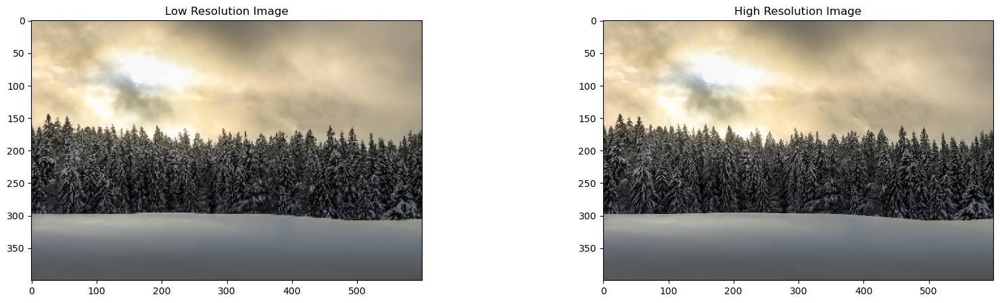

In [9]:
n = 0
for i,m in train_generator:
    img,out = i,m

    if n < 1:
        fig, axs = plt.subplots(1 , 2, figsize=(20,5))
        axs[0].imshow(img[0])
        axs[0].set_title('Low Resolution Image')
        axs[1].imshow(out[0])
        axs[1].set_title('High Resolution Image')
        plt.show()
        n+=1
    else:
        break

In [10]:
train_samples = train_hiresimage_generator.samples
val_samples = val_hiresimage_generator.samples

train_img_gen = imageGenerator(train_generator)
val_img_gen = imageGenerator(val_generator)
test_img_gen = imageGenerator(test_generator)

### Visualizations

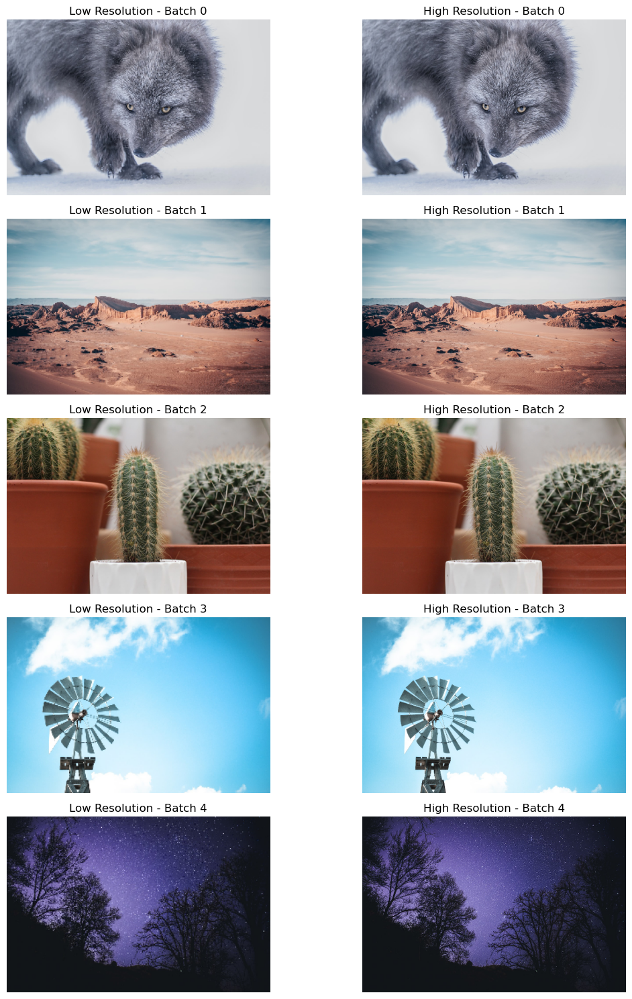

In [11]:
show_random_image(train_img_gen, num_rows=5)

In [12]:
#show_random_image(val_img_gen, num_rows=5)

In [13]:
#show_random_image(test_img_gen, num_rows=5)

## Models

### Standard Convolutional

In [59]:
def build_conv_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(16, (3, 3), padding='same', activation='elu')(input_img)
    conv2 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv1)
    conv3 = Conv2D(64, (3, 3), padding='same', activation='elu')(conv2)
    conv4 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv3)
    conv5 = Conv2D(16, (3, 3), padding='same', activation='elu')(conv4)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv5)

    conv_model = Model(input_img, output_img)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    conv_model.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return conv_model

In [60]:
conv_model = build_conv_model()
conv_model.summary()

Model: "model_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 400, 600, 3)]     0         
                                                                 
 conv2d_87 (Conv2D)          (None, 400, 600, 16)      448       
                                                                 
 conv2d_88 (Conv2D)          (None, 400, 600, 32)      4640      
                                                                 
 conv2d_89 (Conv2D)          (None, 400, 600, 64)      18496     
                                                                 
 conv2d_90 (Conv2D)          (None, 400, 600, 32)      18464     
                                                                 


 conv2d_91 (Conv2D)          (None, 400, 600, 16)      4624      
                                                                 
 conv2d_92 (Conv2D)          (None, 400, 600, 3)       435       
                                                                 
Total params: 47,107
Trainable params: 47,107
Non-trainable params: 0
_________________________________________________________________


In [61]:
conv_model.save("models/conv_model.h5")
print(f"Model size: {os.stat('models/conv_model.h5').st_size / 1024} kB")

Model size: 214.6015625 kB


### Autoencoder

In [13]:
def build_autoencoder_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(16, (3, 3), padding='same', activation='elu')(input_img)
    conv2 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv1)
    maxpool1 = MaxPooling2D(padding='same')(conv2)
    dropout1 = Dropout(0.2)(maxpool1)
    maxpool2 = MaxPooling2D(padding='same')(dropout1)
    conv3 = Conv2D(64, (3, 3), padding='same', activation='elu')(maxpool2)

    # Decoder
    upsample1 = UpSampling2D()(conv3)
    conv4 = Conv2D(64, (3, 3), padding='same', activation='elu')(upsample1)
    conv5 = Conv2D(64, (3, 3), padding='same', activation='elu')(conv4)

    upsample2 = UpSampling2D()(conv5)
    conv6 = Conv2D(32, (3, 3), padding='same', activation='elu')(upsample2)
    conv7 = Conv2D(16, (3, 3), padding='same', activation='elu')(conv6)

    # Output layer
    decoded = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv7)

    # Create and compile Autoencoder model
    autoencoder = Model(input_img, decoded)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    autoencoder.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return autoencoder

In [14]:
autoencoder = build_autoencoder_model()
autoencoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 400, 600, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 400, 600, 16)      448       
                                                                 
 conv2d_1 (Conv2D)           (None, 400, 600, 32)      4640      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 200, 300, 32)     0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 200, 300, 32)      0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 100, 150, 32)     0         
 2D)                                                         

In [15]:
autoencoder.save("models/autoencoder.h5")
print(f"Model size: {os.stat('models/autoencoder.h5').st_size / 1024} kB")

Model size: 516.859375 kB


### U-Net like architecture

In [13]:
def build_u_net(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Encoder
    conv1 = Conv2D(16, (3, 3), padding='same', activation='relu')(input_img)
    conv2 = Conv2D(16, (3, 3), padding='same', activation='relu')(conv1)
    maxpool1 = MaxPooling2D()(conv2)

    conv3 = Conv2D(32, (3, 3), padding='same', activation='relu')(maxpool1)
    conv4 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv3)
    maxpool2 = MaxPooling2D()(conv4)

    conv5 = Conv2D(64, (3, 3), padding='same', activation='relu')(maxpool2)
    conv6 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv5)

    # Bottleneck
    bottleneck = Conv2D(64, (3, 3), padding='same', activation='relu')(conv6)
    maxpool3 = MaxPooling2D(pool_size=(2, 2))(bottleneck)

    # Decoder
    upsample1 = UpSampling2D()(maxpool3)
    concat1 = concatenate([upsample1, conv5], axis=-1)
    conv7 = Conv2D(64, (3, 3), padding='same', activation='relu')(concat1)
    conv8 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv7)

    upsample2 = UpSampling2D()(conv8)
    concat2 = concatenate([upsample2, conv3], axis=-1)
    conv9 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat2)
    conv10 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv9)

    upsample3 = UpSampling2D()(conv10)
    concat3 = concatenate([upsample3, conv1], axis=-1)
    conv11 = Conv2D(16, (3, 3), padding='same', activation='relu')(concat3)
    conv12 = Conv2D(16, (3, 3), padding='same', activation='relu')(conv11)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv12)

    unet = Model(input_img, output_img)    
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    unet.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)
    
    return unet

In [14]:
Unet = build_u_net()
Unet.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 400, 600, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 400, 600, 16  448         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 400, 600, 16  2320        ['conv2d[0][0]']                 
                                )                                                             

In [15]:
Unet.save("models/unet.h5")
print(f"Model size: {os.stat('models/unet.h5').st_size / 1024} kB")

Model size: 1114.8984375 kB


### Inception like model 1

In [13]:
def inception_block(x, filters):
    conv1x1 = Conv2D(filters[0], (1, 1), padding='same', activation='relu')(x)
    conv3x3 = Conv2D(filters[1], (3, 3), padding='same', activation='relu')(x)
    conv5x5 = Conv2D(filters[2], (5, 5), padding='same', activation='relu')(x)
    pool = tf.keras.layers.MaxPooling2D((3, 3), strides=(1, 1), padding='same')(x)
    inception_block = concatenate([conv1x1, conv3x3, conv5x5, pool], axis=-1)

    return inception_block

In [14]:
def build_inception_model(input_shape=INPUT_SHAPE):
    input_img = Input(shape=input_shape)
    inception1 = inception_block(input_img, [8, 8, 8])
    incpetion2 = inception_block(inception1, [16, 16, 16])
    partial_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_1")(incpetion2)
    inception3 = inception_block(incpetion2, [32, 32, 32])
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_2")(inception3)
    
    inception = Model(inputs=input_img, outputs=[output_img, partial_img])    
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    inception.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)
    
    return inception

In [15]:
inception = build_inception_model()
inception.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 400, 600, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 400, 600, 8)  32          ['input_1[0][0]']                
                                                                                                  
 conv2d_1 (Conv2D)              (None, 400, 600, 8)  224         ['input_1[0][0]']                
                                                                                                  
 conv2d_2 (Conv2D)              (None, 400, 600, 8)  608         ['input_1[0][0]']            

In [16]:
inception.save("models/inception.h5")
print(f"Model size: {os.stat('models/inception.h5').st_size / 1024} kB")

Model size: 475.28125 kB


### Inception like model 2

In [14]:
def alt_inception_block(x, filters):
    conv1x1 = Conv2D(filters, (1, 1), padding='same', activation='relu')(x)
    conv1x1_2 = Conv2D(filters, (1, 1), padding='same', activation='relu')(x)
    conv1x1_3 = Conv2D(filters, (1, 1), padding='same', activation='relu')(x)
    conv3x3 = Conv2D(filters, (3, 3), padding='same', activation='relu')(conv1x1_2)
    conv5x5 = Conv2D(filters, (5, 5), padding='same', activation='relu')(conv1x1_3)
    pool = tf.keras.layers.MaxPooling2D((3, 3), strides=(1, 1), padding='same')(x)
    conv1x1_4 = Conv2D(filters, (1, 1), padding='same', activation='relu')(pool)
    inception_block = concatenate([conv1x1, conv3x3, conv5x5, conv1x1_4], axis=-1)

    return inception_block

In [15]:
def build_alt_inception_model(input_shape=INPUT_SHAPE):
    input_img = Input(shape=input_shape)
    
    conv1 = Conv2D(4, (7, 7), padding='same', activation='relu')(input_img)
    maxpool1 = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(conv1)
    batch1 = BatchNormalization()(maxpool1)
    
    conv2 = Conv2D(8, (1, 1), padding='same', activation='relu')(batch1)
    conv3 = Conv2D(8, (1, 1), padding='same', activation='relu')(conv2)
    batch2 = BatchNormalization()(conv3)
    maxpool2 = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(batch2)

    inception1 = alt_inception_block(maxpool2, 8)
    output_img_1 = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_1")(inception1)
    batch3 = BatchNormalization()(inception1)
    incpetion2 = alt_inception_block(batch3, 16)
    output_img_2 = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_2")(incpetion2)
    batch4 = BatchNormalization()(incpetion2)
    inception3 = alt_inception_block(batch4, 32)
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid', name="output_3")(inception3)
    
    inception = Model(inputs=input_img, outputs=[output_img, output_img_1, output_img_2])    
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    inception.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)
    
    return inception

In [16]:
inception_alt = build_alt_inception_model()
inception_alt.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 400, 600, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 400, 600, 4)  592         ['input_1[0][0]']                
                                                                                                  
 max_pooling2d (MaxPooling2D)   (None, 400, 600, 4)  0           ['conv2d[0][0]']                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 400, 600, 4)  16         ['max_pooling2d[0][0]']      

In [17]:
inception_alt.save("models/inception_alt.h5")
print(f"Model size: {os.stat('models/inception_alt.h5').st_size / 1024} kB")

Model size: 381.8828125 kB


### Skip-Connections model

In [13]:
def build_skip_connections_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(16, (3, 3), padding='same', activation='relu')(input_img)
    conv2 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv1)
    conv3 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv2)
    conv4 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv3)
    concat1 = add([conv3, conv4])
    conv5 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv1)
    concat2 = add([concat1, conv5])
    conv6 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat2)
    concat3 = add([concat2, conv6])
    concat4 = add([concat3, conv2])
    conv7 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat4)
    conv8 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv7)
    conv9 = Conv2D(64, (3, 3), padding='same', activation='relu')(conv8)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv9)

    skip_model = Model(input_img, output_img)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    skip_model.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return skip_model

In [14]:
skip_model = build_skip_connections_model()
skip_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 400, 600, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 400, 600, 16  448         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 400, 600, 32  4640        ['conv2d[0][0]']                 
                                )                                                             

In [15]:
skip_model.save("models/skip_model.h5")
print(f"Model size: {os.stat('models/skip_model.h5').st_size / 1024} kB")

Model size: 454.1953125 kB


### Skip-Connections model 2

In [79]:
def build_skip_connections_model_2(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(8, (3, 3), padding='same', activation='relu')(input_img)
    conv1 = Dropout(0.2)(conv1)
    conv2 = Conv2D(16, (3, 3), padding='same', activation='relu')(conv1)
    conv3 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv2)
    conv3 = BatchNormalization()(conv3)
    concat1 = concatenate([conv1, conv3], axis=-1)

    conv4 = Conv2D(32, (3, 3), padding='same', activation='relu')(concat1)
    conv5 = Conv2D(32, (3, 3), padding='same', activation='relu')(conv4)
    conv5 = BatchNormalization()(conv5)
    concat2 = concatenate([conv2, conv5], axis=-1)
    concat3 = concatenate([concat1, concat2], axis=-1)
    conv6 = Conv2D(64, (3, 3), padding='same', activation='relu')(concat3)
    conv6 = Dropout(0.2)(conv6)
    hidden_conv = Conv2D(8, (7, 7), padding='same', activation='elu')(conv1)
    hidden_conv = AveragePooling2D((5, 5), strides=(1, 1), padding='same')(hidden_conv) 
    concat4 = concatenate([conv6, hidden_conv], axis=-1)
    conv7 = Conv2D(64, (3, 3), padding='same', activation='elu')(concat4)

    # Output layer
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv7)

    skip_model = Model(input_img, output_img)
    metrics_list = ['accuracy', MeanAbsoluteError(name='mae'), RootMeanSquaredError(name='rmse')]
    skip_model.compile(optimizer='adam', loss='mean_squared_error', metrics=metrics_list)

    return skip_model

In [80]:
skip_model_2 = build_skip_connections_model_2()
skip_model_2.summary()

Model: "model_15"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_16 (InputLayer)          [(None, 400, 600, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_155 (Conv2D)            (None, 400, 600, 8)  224         ['input_16[0][0]']               
                                                                                                  
 dropout_4 (Dropout)            (None, 400, 600, 8)  0           ['conv2d_155[0][0]']             
                                                                                                  
 conv2d_156 (Conv2D)            (None, 400, 600, 16  1168        ['dropout_4[0][0]']       

In [81]:
skip_model_2.save("models/skip_model_2.h5")
print(f"Model size: {os.stat('models/skip_model_2.h5').st_size / 1024} kB")

Model size: 546.6953125 kB


### GANs

In [82]:
def make_generator_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(8, (3, 3), padding='same', activation='elu')(input_img)
    conv2 = Conv2D(16, (3, 3), padding='same', activation='elu')(conv1)
    conv3 = Conv2D(32, (3, 3), padding='same', activation='elu')(conv2)
    conv4 = Conv2D(64, (3, 3), padding='same', activation='elu')(conv3)
    concat1 = concatenate([conv2, conv4], axis=-1)
    conv5 = Conv2D(64, (3, 3), padding='same', activation='elu')(concat1)
    output_img = Conv2D(3, (3, 3), padding='same', activation='sigmoid')(conv5)

    # Create the model
    generator_model = Model(inputs=input_img, outputs=output_img)
    return generator_model

In [83]:
generator = make_generator_model()
generator.summary()

Model: "model_16"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_17 (InputLayer)          [(None, 400, 600, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_164 (Conv2D)            (None, 400, 600, 8)  224         ['input_17[0][0]']               
                                                                                                  
 conv2d_165 (Conv2D)            (None, 400, 600, 16  1168        ['conv2d_164[0][0]']             
                                )                                                                 
                                                                                           

In [84]:
generator.save("models/generator.h5")
print(f"Model size: {os.stat('models/generator.h5').st_size / 1024} kB")

Model size: 312.8828125 kB


In [85]:
def make_discriminator_model(input_shape=INPUT_SHAPE):
    # Input layer
    input_img = Input(shape=input_shape)

    # Convolutional layers
    conv1 = Conv2D(8, (7, 7), activation='relu')(input_img)
    conv2 = Conv2D(16, (7, 7), activation='relu')(conv1)
    conv3 = Conv2D(32, (7, 7), activation='relu')(conv2)
    conv4 = Conv2D(4, (7, 7), activation='relu')(conv3)
    maxpool1 = MaxPooling2D((7, 7))(conv4)
    flatten = Flatten()(maxpool1)
    output_img = Dense(1, activation='sigmoid')(flatten)

    # Create the model
    discriminator_model = Model(inputs=input_img, outputs=output_img)
    return discriminator_model

In [86]:
discriminator = make_discriminator_model()
discriminator.summary()

Model: "model_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_18 (InputLayer)       [(None, 400, 600, 3)]     0         
                                                                 
 conv2d_170 (Conv2D)         (None, 394, 594, 8)       1184      
                                                                 
 conv2d_171 (Conv2D)         (None, 388, 588, 16)      6288      
                                                                 
 conv2d_172 (Conv2D)         (None, 382, 582, 32)      25120     
                                                                 
 conv2d_173 (Conv2D)         (None, 376, 576, 4)       6276      
                                                                 
 max_pooling2d_27 (MaxPoolin  (None, 53, 82, 4)        0         
 g2D)                                                            
                                                          

In [87]:
discriminator.save("models/discriminator.h5")
print(f"Model size: {os.stat('models/discriminator.h5').st_size / 1024} kB")

Model size: 249.296875 kB


In [88]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [89]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [90]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [91]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

## Training

### Functions and Callbacks

In [16]:
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr_plateau = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, verbose=1)
tensorboard = TensorBoard(log_dir='logs')

In [17]:
def plot_history(history, model_name, inception_outputs=None):
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'Training and Validation Loss {model_name}')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()
    
    if inception_outputs:
        for out in inception_outputs:
            plt.plot(history.history[f'{out}_loss'], label='Training Loss')
            plt.plot(history.history[f'val_{out}_loss'], label='Validation Loss')
            plt.title(f'Training and Validation Loss {model_name} {out}')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend()
            plt.show()

In [18]:
def plot_metrics(history, model_name, inception_outputs=None):
    # Plot training and validation accuracy
    if inception_outputs:
        for out in inception_outputs:
            plt.figure(figsize=(12, 10))
            plt.subplot(3, 1, 1)
                
            plt.plot(history.history[f'{out}_accuracy'], label=f'{out} training Accuracy')
            plt.plot(history.history[f'val_{out}_accuracy'], label=f'{out} validation Accuracy')
            plt.title(f'Training and Validation Accuracy {model_name} {out}')
            plt.xlabel('Epoch')
            plt.ylabel('Accuracy')
            plt.legend()

            # Plot training and validation MAE
            plt.subplot(3, 1, 2)
            plt.plot(history.history[f'{out}_mae'], label='Training MAE')
            plt.plot(history.history[f'val_{out}_mae'], label='Validation MAE')
            plt.title(f'Training and Validation MAE {model_name} {out}')
            plt.xlabel('Epoch')
            plt.ylabel('MAE')
            plt.legend()

            # Plot training and validation RMSE
            plt.subplot(3, 1, 3)
            plt.plot(history.history[f'{out}_rmse'], label='Training RMSE')
            plt.plot(history.history[f'val_{out}_rmse'], label='Validation RMSE')
            plt.title(f'Training and Validation RMSE {model_name} {out}')
            plt.xlabel('Epoch')
            plt.ylabel('RMSE')
            plt.legend()

            plt.tight_layout()
            plt.show()
    else:
        plt.figure(figsize=(12, 10))
        plt.subplot(3, 1, 1)

        plt.plot(history.history['accuracy'], label='Training Accuracy')
        plt.plot(history.history['val_accuracy'], label='Validation Accuracy')

        plt.title(f'Training and Validation Accuracy {model_name}')
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()

        # Plot training and validation MAE
        plt.subplot(3, 1, 2)
        plt.plot(history.history['mae'], label='Training MAE')
        plt.plot(history.history['val_mae'], label='Validation MAE')
        plt.title(f'Training and Validation MAE {model_name}')
        plt.xlabel('Epoch')
        plt.ylabel('MAE')
        plt.legend()

        # Plot training and validation RMSE
        plt.subplot(3, 1, 3)
        plt.plot(history.history['rmse'], label='Training RMSE')
        plt.plot(history.history['val_rmse'], label='Validation RMSE')
        plt.title(f'Training and Validation RMSE {model_name}')
        plt.xlabel('Epoch')
        plt.ylabel('RMSE')
        plt.legend()

        plt.tight_layout()
        plt.show()


In [19]:
def plot_predictions(model, generator, num_examples=5, seed=42, size=(12, 4)):
    np.random.seed(seed)

    for _ in range(num_examples):
        x_sample, y_sample = next(generator)

        # Predict
        y_pred = model.predict(x_sample, verbose=False)

        # Plot
        plt.figure(figsize=size)
        plt.subplot(1, 3, 1)
        plt.imshow(x_sample[0], cmap='gray')
        plt.title('Original')

        plt.subplot(1, 3, 2)
        plt.imshow(y_sample[0], cmap='gray')
        plt.title('Expected')

        plt.subplot(1, 3, 3)
        plt.imshow(y_pred[0], cmap='gray')
        plt.title('Reconstructed by Model')

        plt.show()

In [20]:
def plot_predictions_many_outputs(model, generator, num_examples=5, seed=42, size=(16, 4)):
    np.random.seed(seed)

    for _ in range(num_examples):
        x_sample, y_sample = next(generator)

        # Predict
        y_preds = model.predict(x_sample, verbose=False)

        # Plot
        plt.figure(figsize=size)

        # Plot original input
        plt.subplot(1, len(y_preds) + 2, 1)
        plt.imshow(x_sample[0], cmap='gray')
        plt.title('Original')

        # Plot ground truth
        plt.subplot(1, len(y_preds) + 2, 2)
        plt.imshow(y_sample[0], cmap='gray')
        plt.title('Expected')

        # Plot model predictions
        for j, y_pred in enumerate(y_preds):
            plt.subplot(1, len(y_preds) + 2, j + 3)
            plt.imshow(y_pred[0], cmap='gray')
            plt.title(f'Reconstructed by Model (Output {j + 1})')

        plt.show()

In [21]:
model_times = {}

### Standard Convolutional

In [98]:
start_time = time.time()

history = conv_model.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

end_time = time.time()
training_time = end_time - start_time
model_name = "Standard Convolutional Model"
time_dict = {model_name: training_time}

Epoch 1/100
376/376 [==============================] - 167s 405ms/step - loss: 0.0083 - accuracy: 0.8071 - mae: 0.0588 - rmse: 0.0912 - val_loss: 0.0047 - val_accuracy: 0.8215 - val_mae: 0.0473 - val_rmse: 0.0685 - lr: 0.0010
Epoch 2/100
376/376 [==============================] - 101s 270ms/step - loss: 0.0035 - accuracy: 0.8493 - mae: 0.0370 - rmse: 0.0588 - val_loss: 0.0031 - val_accuracy: 0.8459 - val_mae: 0.0310 - val_rmse: 0.0560 - lr: 0.0010
Epoch 3/100
376/376 [==============================] - 101s 268ms/step - loss: 0.0028 - accuracy: 0.8611 - mae: 0.0296 - rmse: 0.0531 - val_loss: 0.0030 - val_accuracy: 0.8563 - val_mae: 0.0277 - val_rmse: 0.0546 - lr: 0.0010
Epoch 4/100
376/376 [==============================] - 96s 256ms/step - loss: 0.0029 - accuracy: 0.8605 - mae: 0.0294 - rmse: 0.0534 - val_loss: 0.0030 - val_accuracy: 0.8798 - val_mae: 0.0274 - val_rmse: 0.0546 - lr: 0.0010
Epoch 5/100
376/376 [==============================] - 96s 255ms/step - loss: 0.0027 - accuracy: 

#### Save model

In [99]:
conv_model.save('models/trained_conv_model.h5')
print(f"Model size: {os.stat('models/trained_conv_model.h5').st_size / 1024} kB")

Model size: 611.2109375 kB


#### History Plot

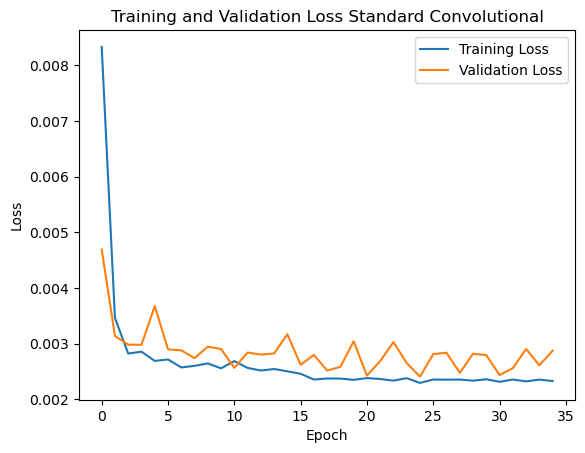

In [100]:
plot_history(history, "Standard Convolutional")

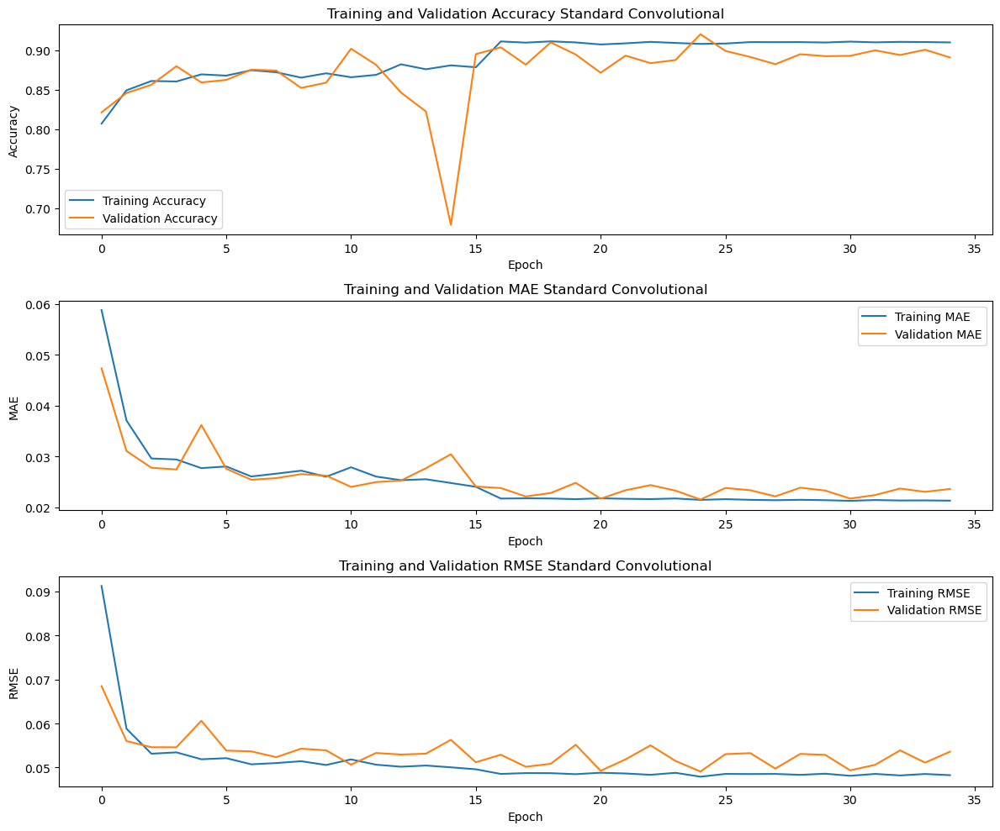

In [101]:
plot_metrics(history, "Standard Convolutional")

#### Predictions for Training set

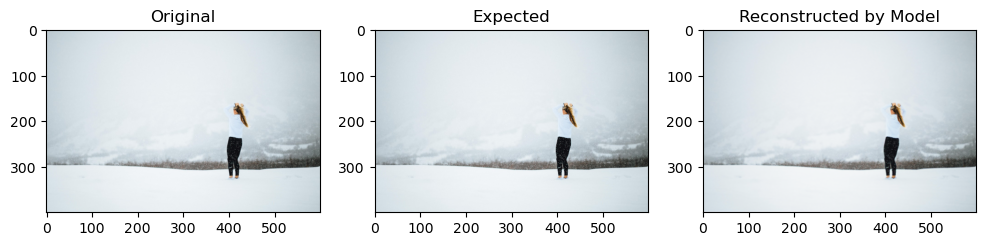

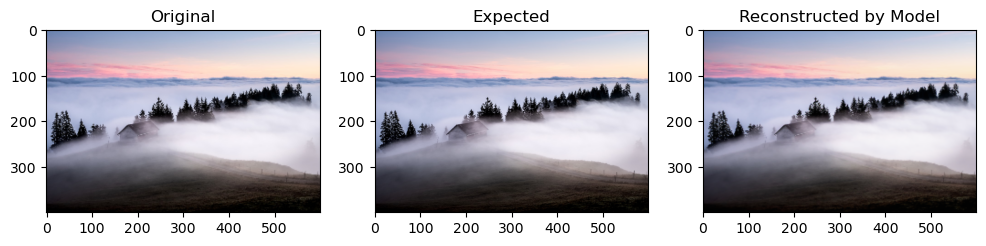

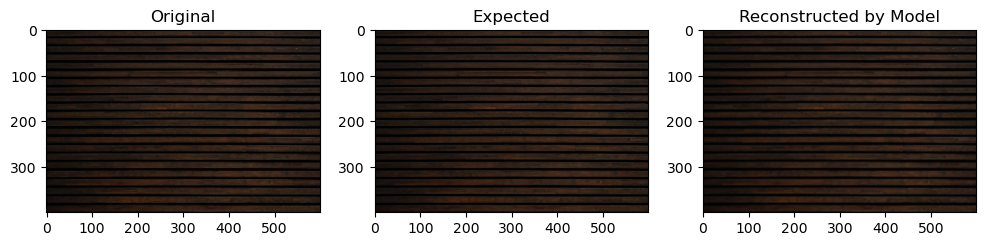

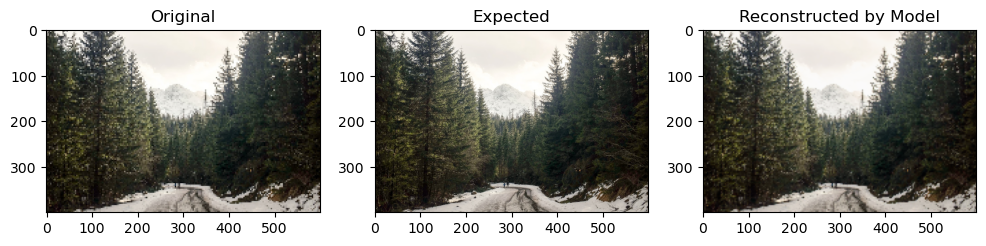

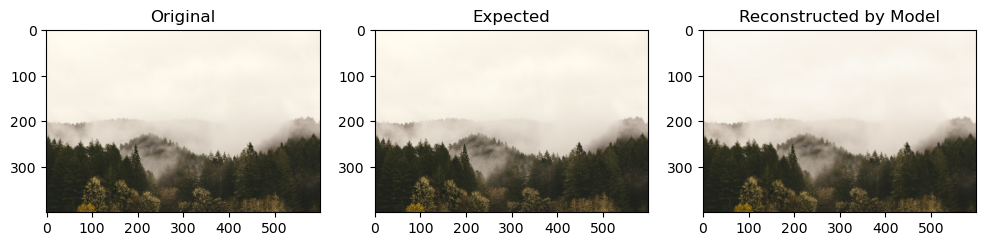

In [102]:
plot_predictions(conv_model, train_img_gen)

#### Predictions for Test set

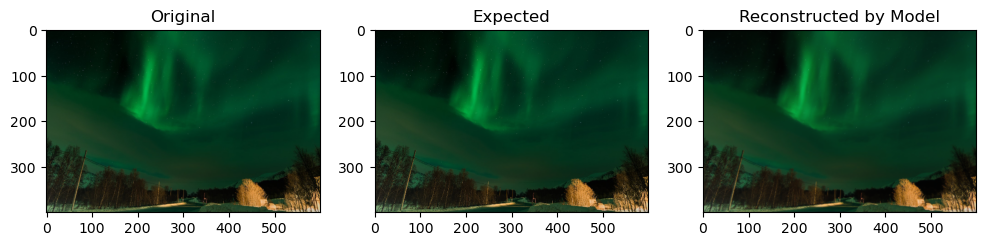

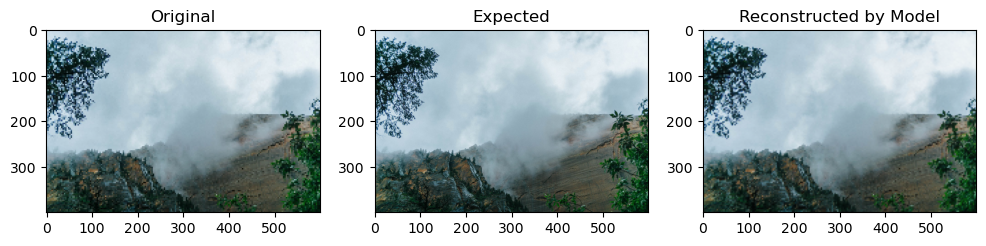

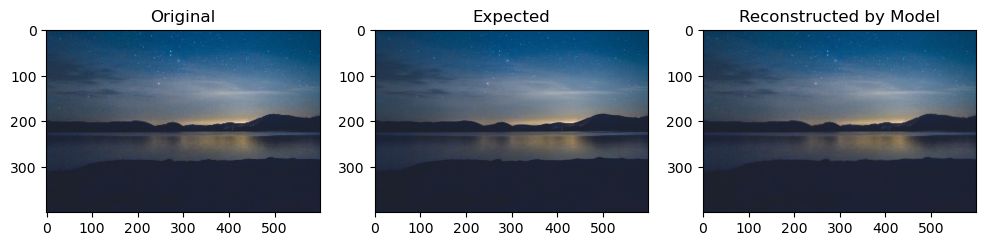

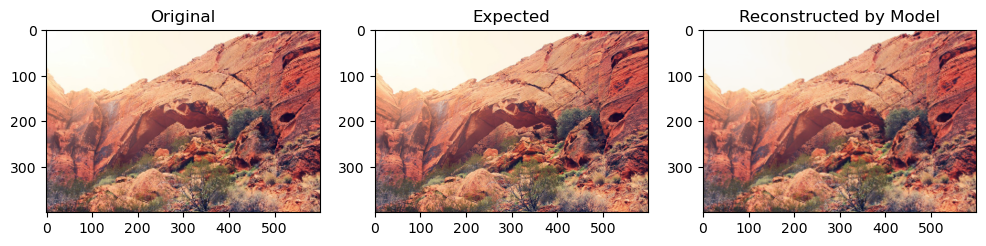

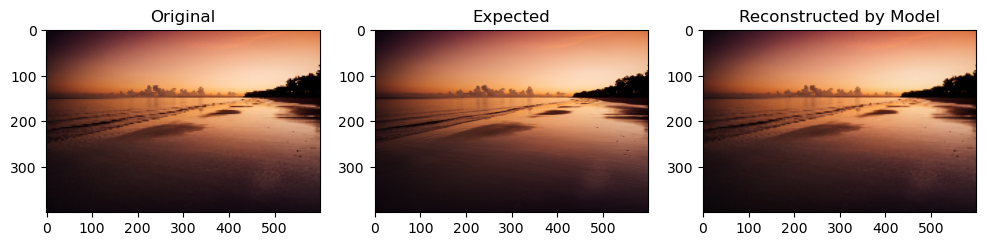

In [103]:
plot_predictions(conv_model, test_img_gen)

### Autoencoder

In [22]:
start_time = time.time()

history = autoencoder.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

end_time = time.time()
training_time = end_time - start_time
model_name = "Autoencoder"
time_dict = {model_name: training_time}

Epoch 1/100
376/376 [==============================] - 101s 251ms/step - loss: 0.0086 - accuracy: 0.7562 - mae: 0.0607 - rmse: 0.0928 - val_loss: 0.0073 - val_accuracy: 0.7748 - val_mae: 0.0608 - val_rmse: 0.0855 - lr: 0.0010
Epoch 2/100
376/376 [==============================] - 90s 241ms/step - loss: 0.0045 - accuracy: 0.7795 - mae: 0.0425 - rmse: 0.0674 - val_loss: 0.0063 - val_accuracy: 0.7693 - val_mae: 0.0562 - val_rmse: 0.0796 - lr: 0.0010
Epoch 3/100
376/376 [==============================] - 93s 246ms/step - loss: 0.0045 - accuracy: 0.7869 - mae: 0.0406 - rmse: 0.0668 - val_loss: 0.0047 - val_accuracy: 0.8098 - val_mae: 0.0431 - val_rmse: 0.0684 - lr: 0.0010
Epoch 4/100
376/376 [==============================] - 92s 244ms/step - loss: 0.0039 - accuracy: 0.8219 - mae: 0.0371 - rmse: 0.0626 - val_loss: 0.0068 - val_accuracy: 0.7408 - val_mae: 0.0608 - val_rmse: 0.0825 - lr: 0.0010
Epoch 5/100
376/376 [==============================] - 92s 245ms/step - loss: 0.0037 - accuracy: 0.

#### Save model

In [28]:
autoencoder.save('models/trained_autoencoder.h5')
print(f"Model size: {os.stat('models/trained_autoencoder.h5').st_size / 1024} kB")

Model size: 1497.1484375 kB


#### History Plot

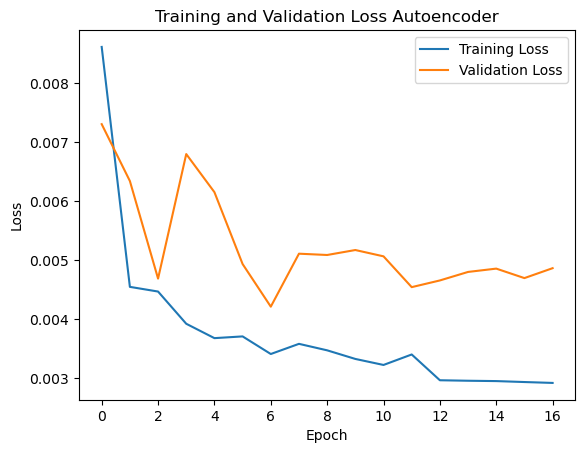

In [24]:
plot_history(history, "Autoencoder")

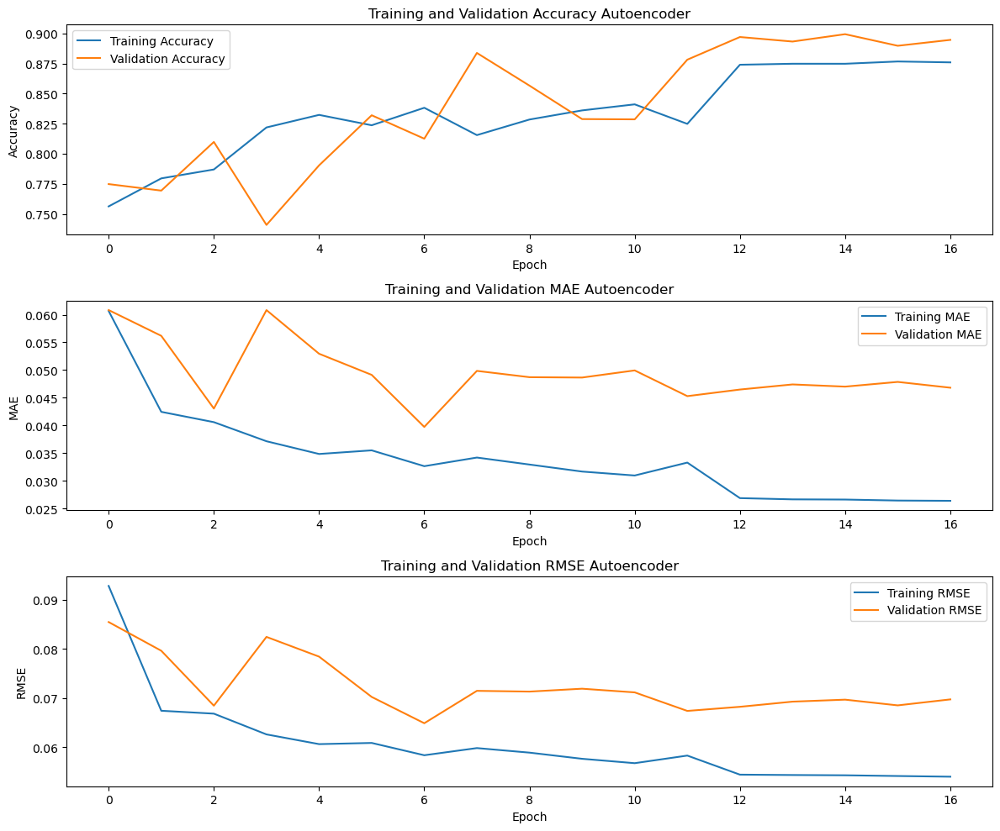

In [25]:
plot_metrics(history, "Autoencoder")

#### Predictions for Training set

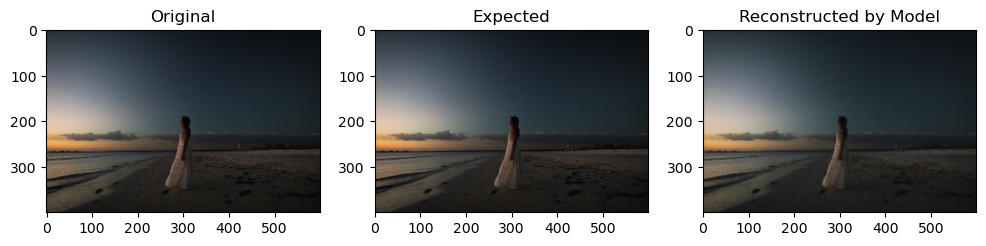

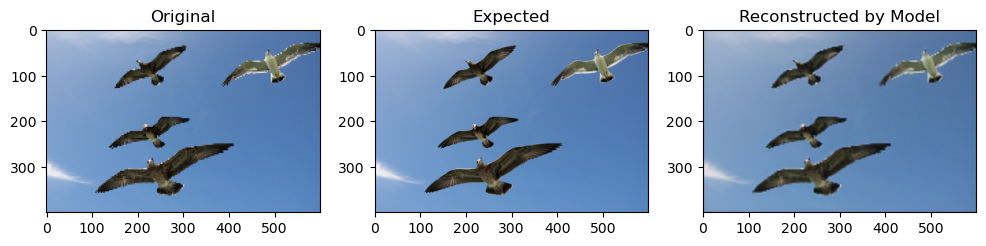

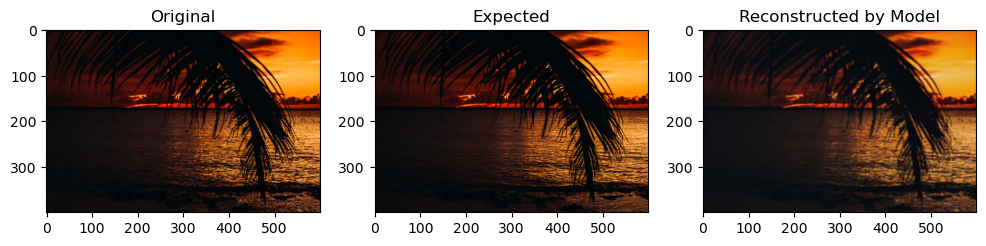

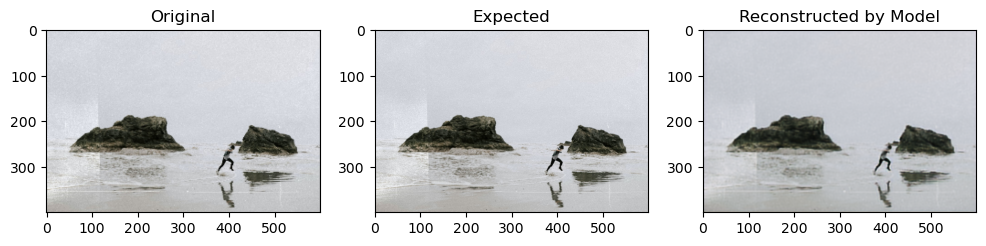

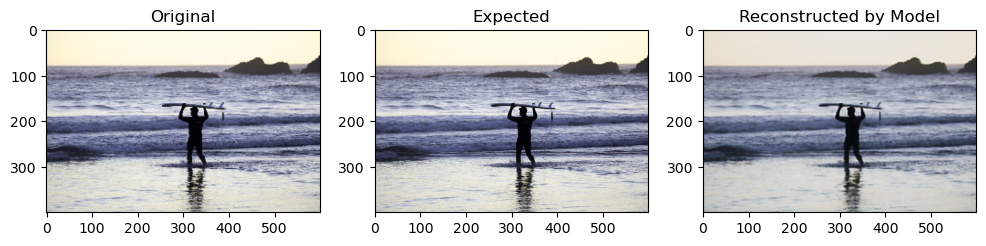

In [26]:
plot_predictions(autoencoder, train_img_gen)

#### Predictions for Test set

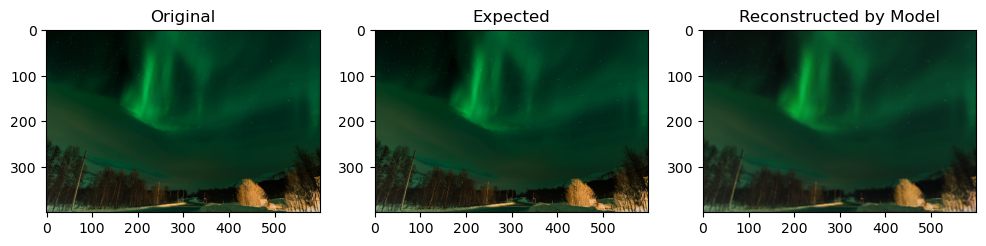

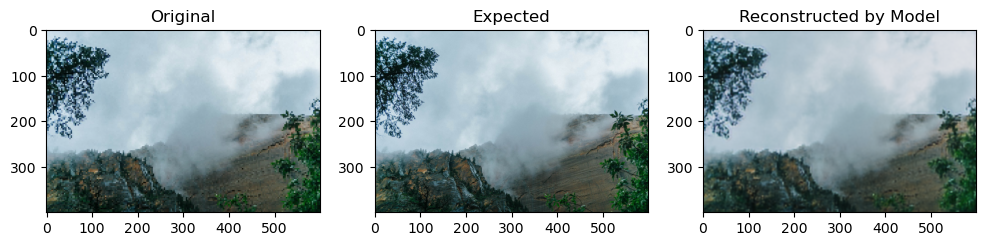

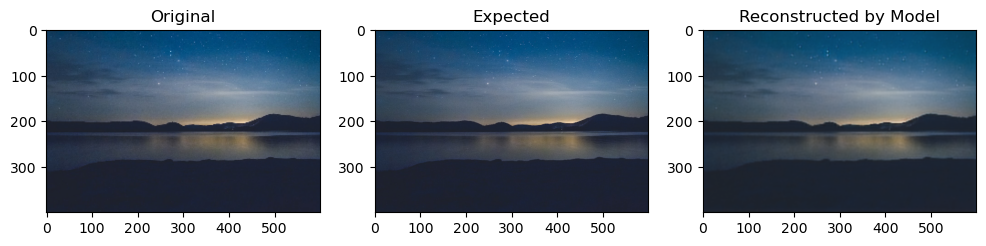

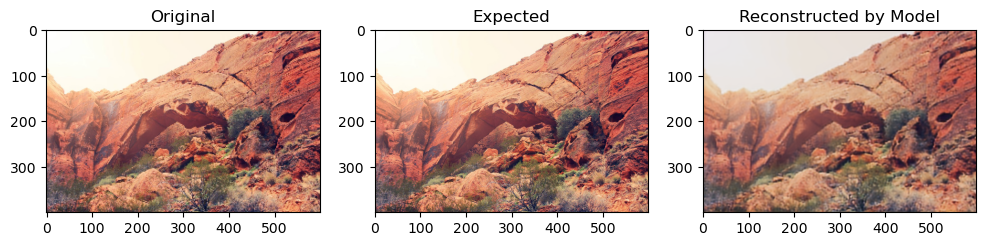

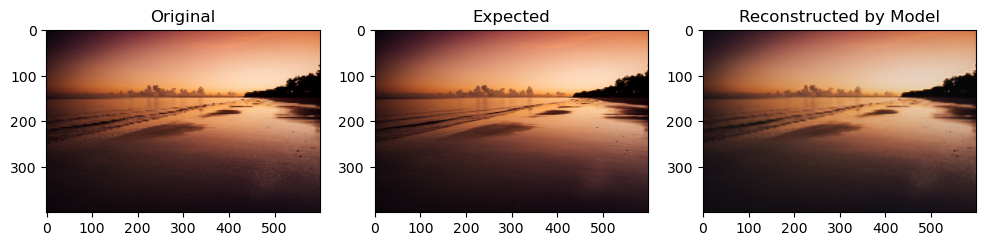

In [27]:
plot_predictions(autoencoder, test_img_gen)

### U-net like network

In [22]:
start_time = time.time()

history = Unet.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

end_time = time.time()
training_time = end_time - start_time
model_name = "Unet"
time_dict = {model_name: training_time}

Epoch 1/100
376/376 [==============================] - 103s 258ms/step - loss: 0.0090 - accuracy: 0.7246 - mae: 0.0540 - rmse: 0.0949 - val_loss: 0.0037 - val_accuracy: 0.7991 - val_mae: 0.0349 - val_rmse: 0.0605 - lr: 0.0010
Epoch 2/100
376/376 [==============================] - 97s 257ms/step - loss: 0.0031 - accuracy: 0.8506 - mae: 0.0319 - rmse: 0.0557 - val_loss: 0.0032 - val_accuracy: 0.8512 - val_mae: 0.0312 - val_rmse: 0.0566 - lr: 0.0010
Epoch 3/100
376/376 [==============================] - 96s 256ms/step - loss: 0.0028 - accuracy: 0.8687 - mae: 0.0273 - rmse: 0.0525 - val_loss: 0.0031 - val_accuracy: 0.8198 - val_mae: 0.0295 - val_rmse: 0.0559 - lr: 0.0010
Epoch 4/100
376/376 [==============================] - 96s 254ms/step - loss: 0.0027 - accuracy: 0.8693 - mae: 0.0267 - rmse: 0.0518 - val_loss: 0.0030 - val_accuracy: 0.8483 - val_mae: 0.0281 - val_rmse: 0.0550 - lr: 0.0010
Epoch 5/100
376/376 [==============================] - 95s 253ms/step - loss: 0.0027 - accuracy: 0.

#### Save model

In [23]:
Unet.save("models/trained_unet.h5")
print(f"Model size: {os.stat('models/trained_unet.h5').st_size / 1024} kB")

Model size: 3257.4765625 kB


#### History Plot

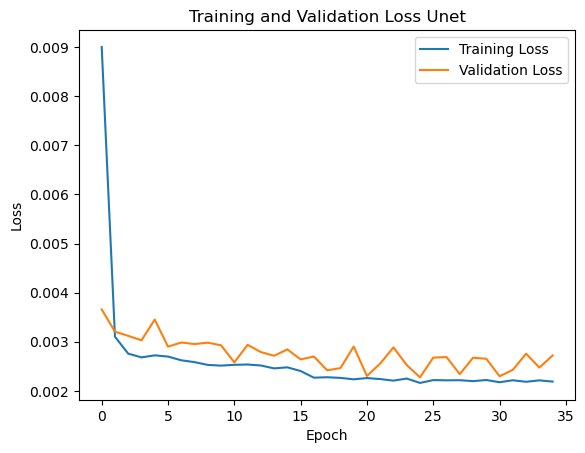

In [24]:
plot_history(history, "Unet")

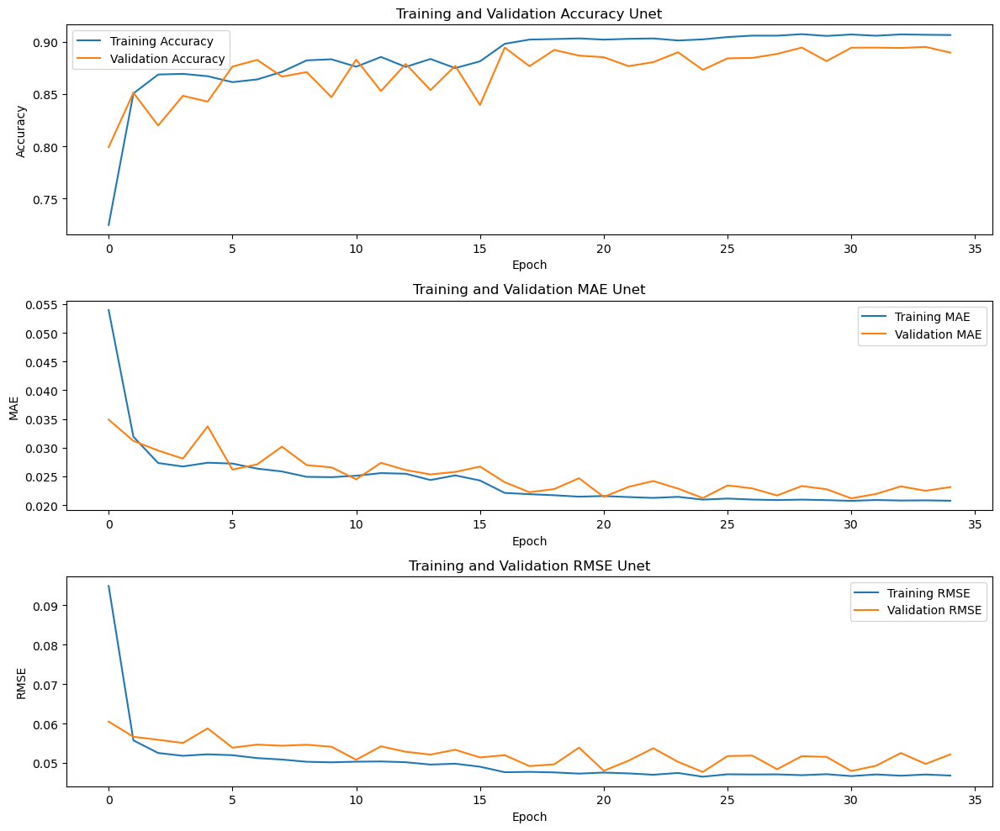

In [25]:
plot_metrics(history, "Unet")

#### Predictions for Training set

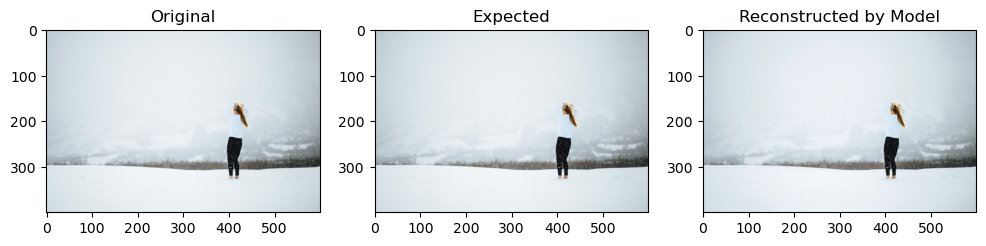

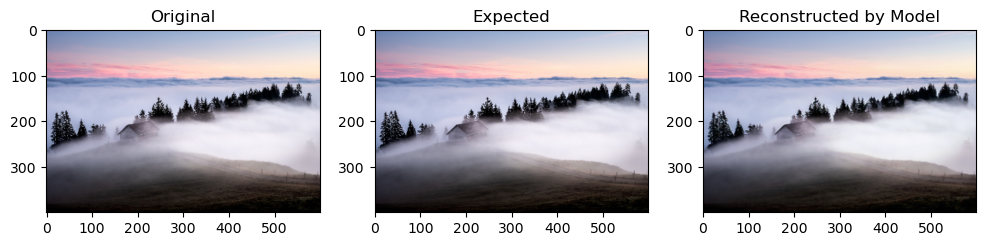

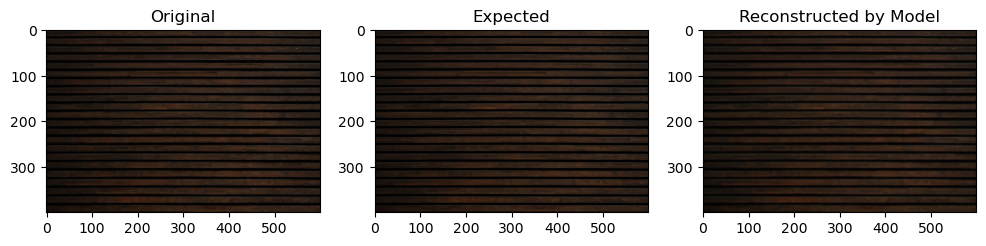

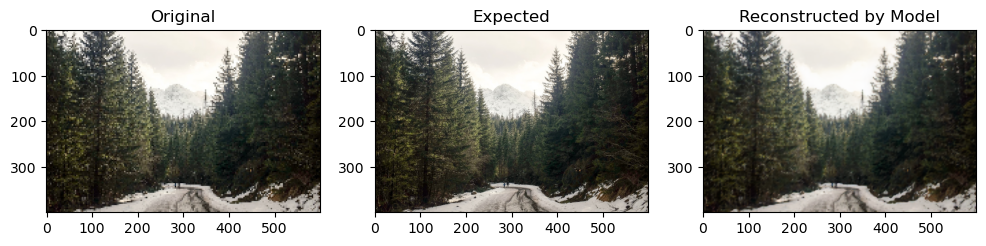

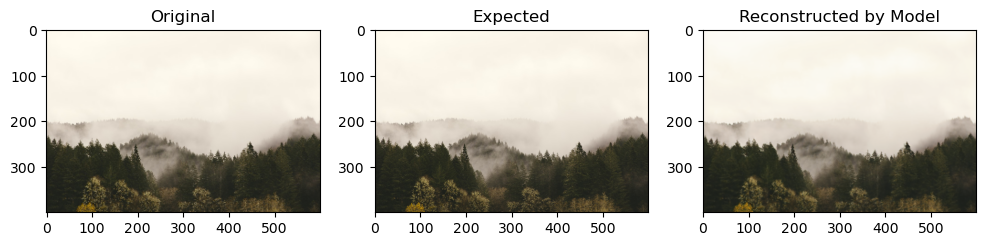

In [26]:
plot_predictions(Unet,train_img_gen)

#### Predictions for Test set

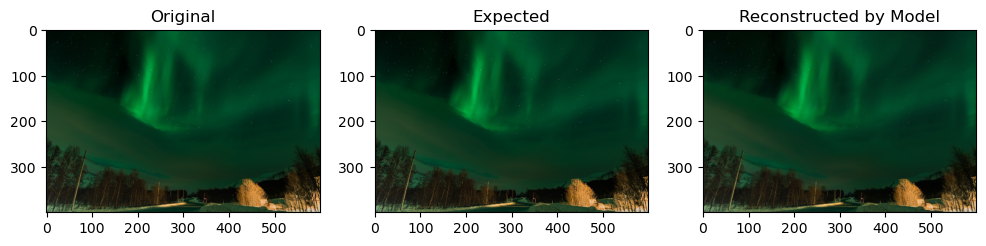

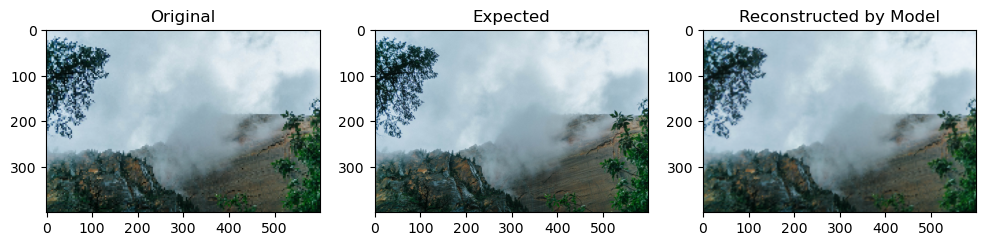

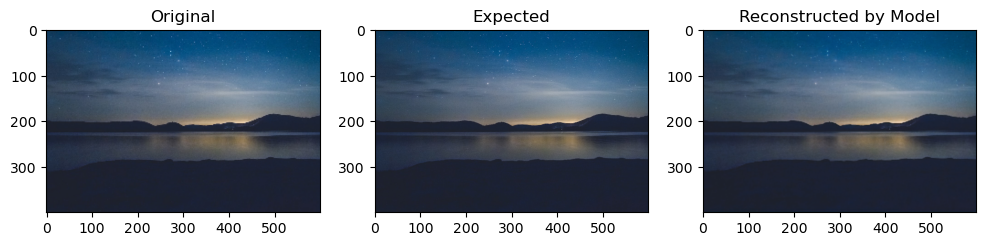

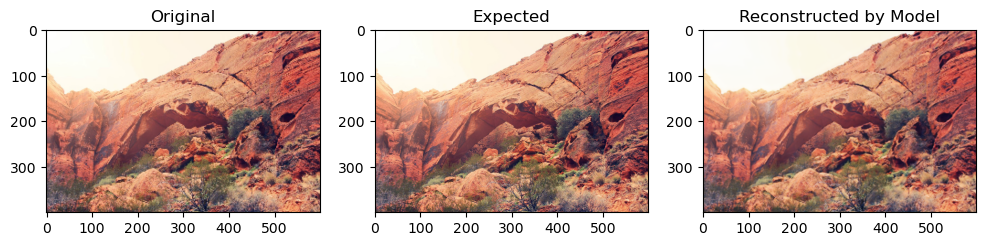

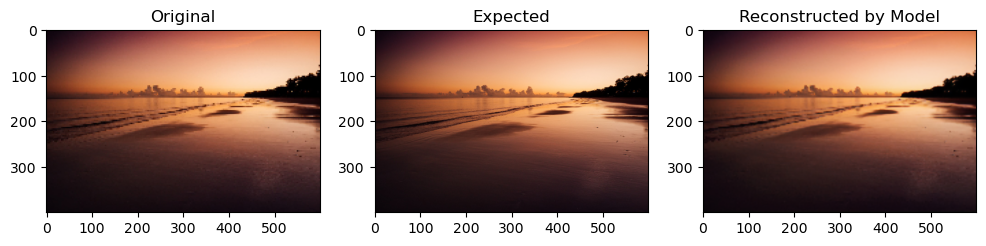

In [27]:
plot_predictions(Unet, test_img_gen)

### Inception like model 1

In [23]:
start_time = time.time()

history = inception.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

end_time = time.time()
training_time = end_time - start_time
model_name = "Simpler Inception"
time_dict = {model_name: training_time}

Epoch 1/100
752/752 [==============================] - 251s 322ms/step - loss: 0.0170 - output_2_loss: 0.0080 - output_1_loss: 0.0090 - output_2_accuracy: 0.8164 - output_2_mae: 0.0489 - output_2_rmse: 0.0894 - output_1_accuracy: 0.8034 - output_1_mae: 0.0540 - output_1_rmse: 0.0947 - val_loss: 0.0066 - val_output_2_loss: 0.0032 - val_output_1_loss: 0.0035 - val_output_2_accuracy: 0.8337 - val_output_2_mae: 0.0290 - val_output_2_rmse: 0.0561 - val_output_1_accuracy: 0.8501 - val_output_1_mae: 0.0333 - val_output_1_rmse: 0.0591 - lr: 0.0010
Epoch 2/100
752/752 [==============================] - 219s 292ms/step - loss: 0.0058 - output_2_loss: 0.0028 - output_1_loss: 0.0030 - output_2_accuracy: 0.8682 - output_2_mae: 0.0279 - output_2_rmse: 0.0527 - output_1_accuracy: 0.8640 - output_1_mae: 0.0308 - output_1_rmse: 0.0549 - val_loss: 0.0060 - val_output_2_loss: 0.0029 - val_output_1_loss: 0.0031 - val_output_2_accuracy: 0.8427 - val_output_2_mae: 0.0265 - val_output_2_rmse: 0.0540 - val_ou

#### Save model

In [24]:
inception.save('models/trained_inception.h5')
print(f"Model size: {os.stat('models/trained_inception.h5').st_size / 1024} kB")

Model size: 1358.9140625 kB


#### History Plot

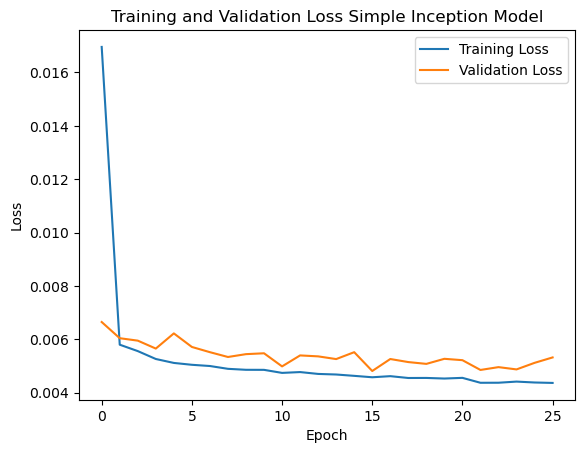

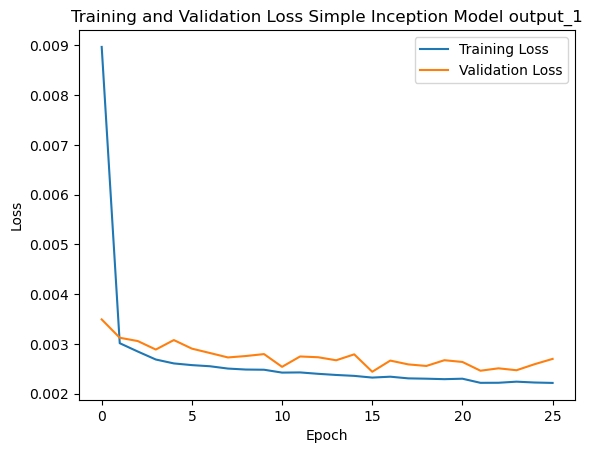

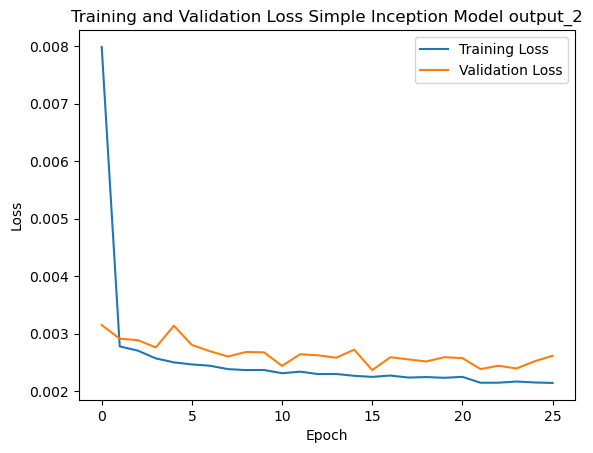

In [33]:
plot_history(history, "Simple Inception Model", inception_outputs=["output_1", "output_2"])

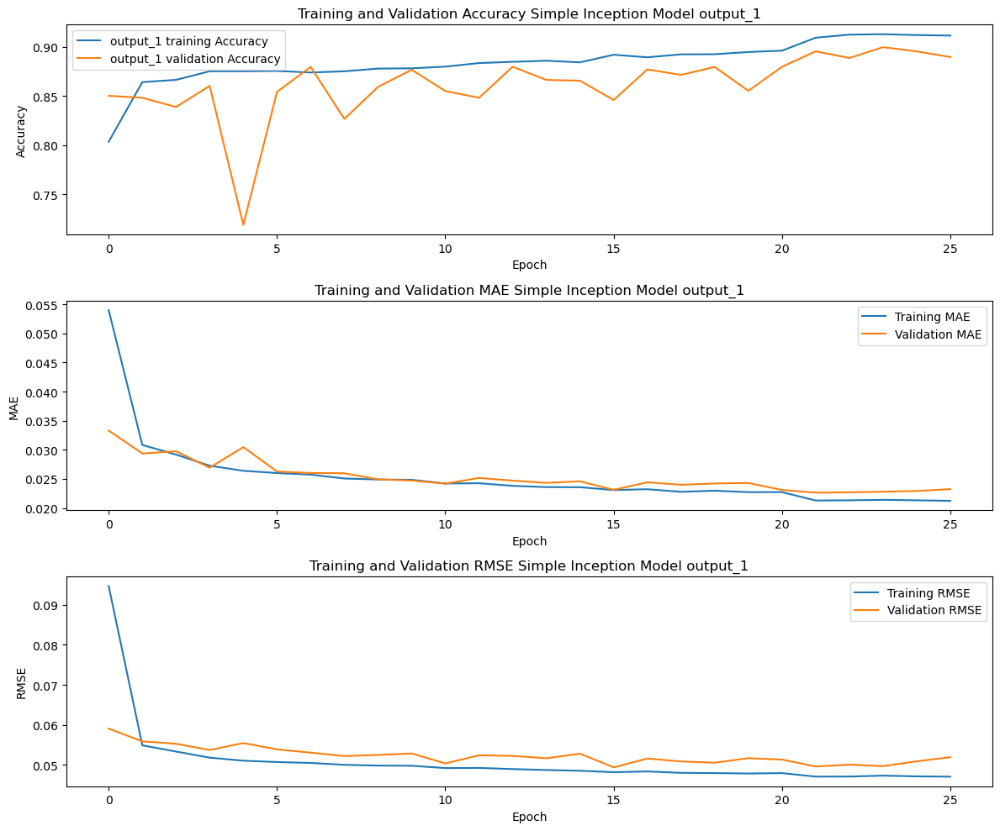

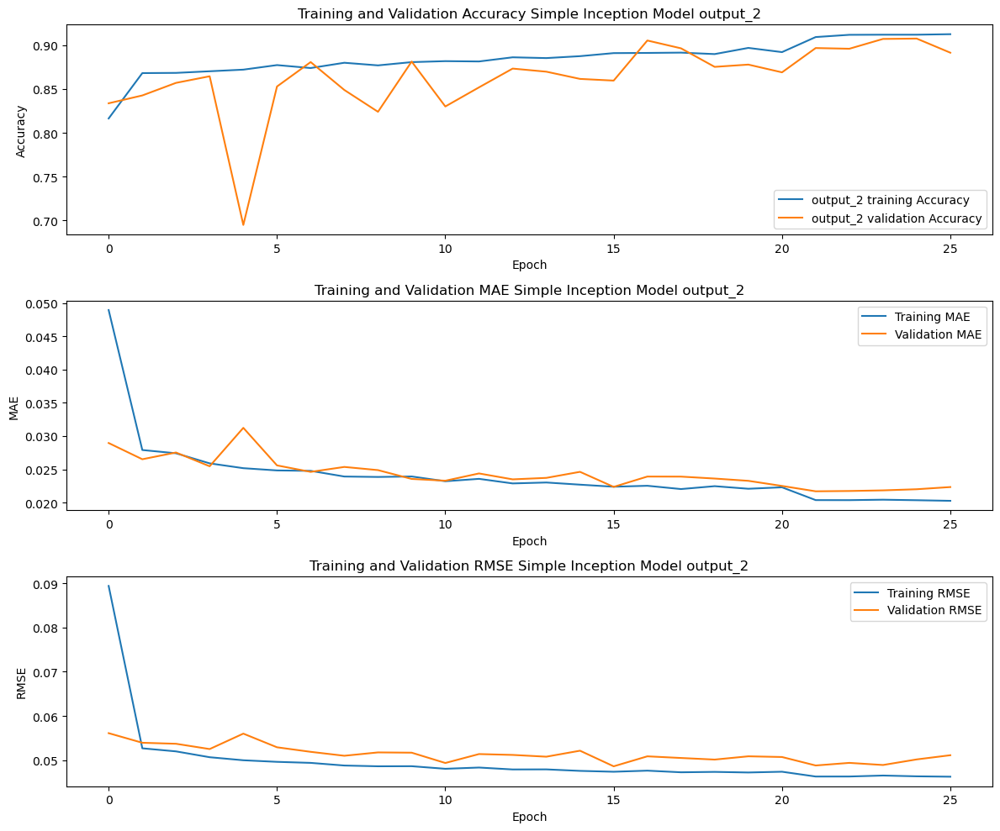

In [36]:
plot_metrics(history, "Simple Inception Model", inception_outputs=["output_1", "output_2"])

#### Predictions for Training set

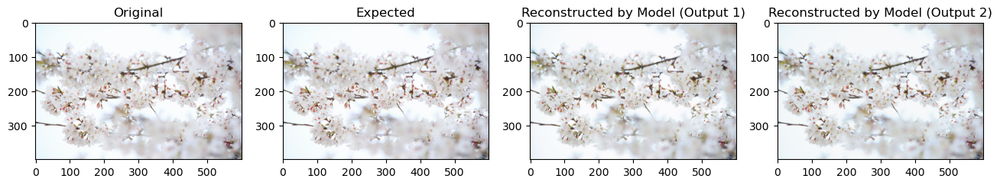

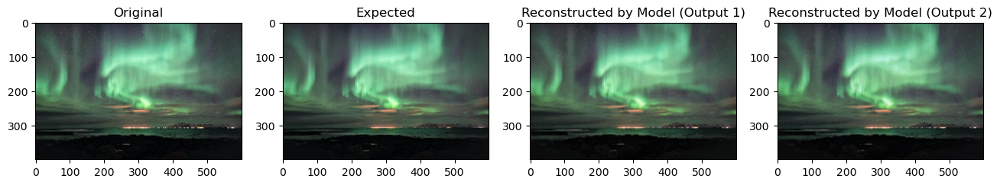

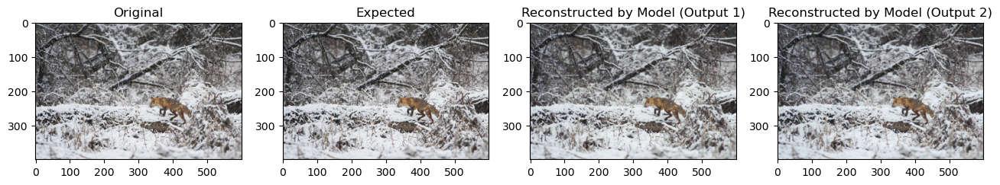

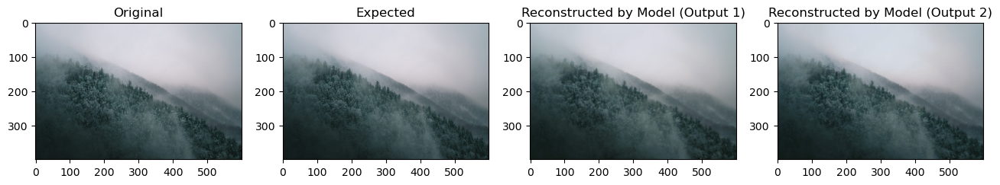

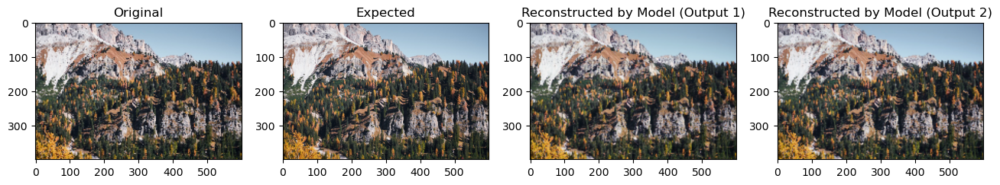

In [37]:
plot_predictions_many_outputs(inception, train_img_gen)

#### Predictions for Test set

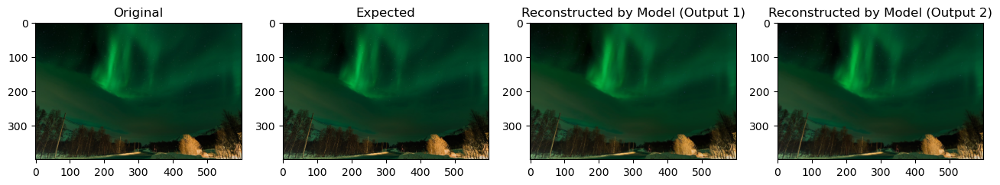

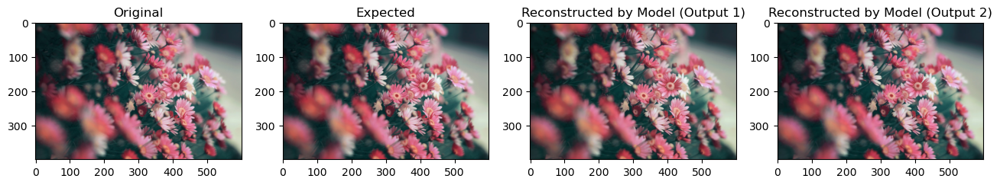

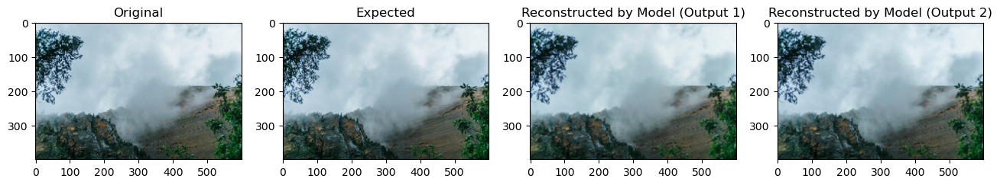

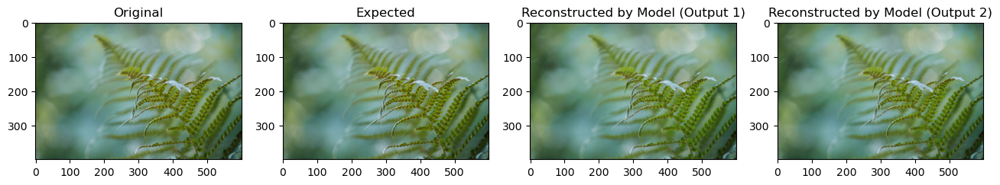

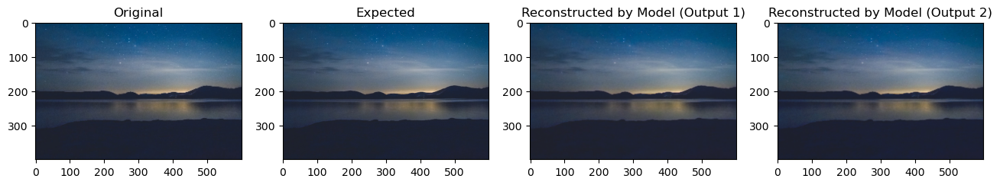

In [38]:
plot_predictions_many_outputs(inception, test_img_gen)

### Inception like model 2

In [24]:
start_time = time.time()

history = inception_alt.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

end_time = time.time()
training_time = end_time - start_time
model_name = "Alternative Inception"
time_dict = {model_name: training_time}

Epoch 1/100
752/752 [==============================] - 244s 315ms/step - loss: 0.0604 - output_3_loss: 0.0186 - output_1_loss: 0.0219 - output_2_loss: 0.0199 - output_3_accuracy: 0.5341 - output_3_mae: 0.0994 - output_3_rmse: 0.1363 - output_1_accuracy: 0.5236 - output_1_mae: 0.1101 - output_1_rmse: 0.1481 - output_2_accuracy: 0.5257 - output_2_mae: 0.1033 - output_2_rmse: 0.1409 - val_loss: 0.0262 - val_output_3_loss: 0.0086 - val_output_1_loss: 0.0091 - val_output_2_loss: 0.0085 - val_output_3_accuracy: 0.5667 - val_output_3_mae: 0.0667 - val_output_3_rmse: 0.0929 - val_output_1_accuracy: 0.5616 - val_output_1_mae: 0.0649 - val_output_1_rmse: 0.0956 - val_output_2_accuracy: 0.5557 - val_output_2_mae: 0.0635 - val_output_2_rmse: 0.0919 - lr: 0.0010
Epoch 2/100
752/752 [==============================] - 222s 295ms/step - loss: 0.0395 - output_3_loss: 0.0114 - output_1_loss: 0.0154 - output_2_loss: 0.0127 - output_3_accuracy: 0.5957 - output_3_mae: 0.0769 - output_3_rmse: 0.1066 - outpu

#### Save model

In [25]:
inception_alt.save('models/trained_inception_alt.h5')
print(f"Model size: {os.stat('models/trained_inception_alt.h5').st_size / 1024} kB")

Model size: 999.078125 kB


#### History Plot

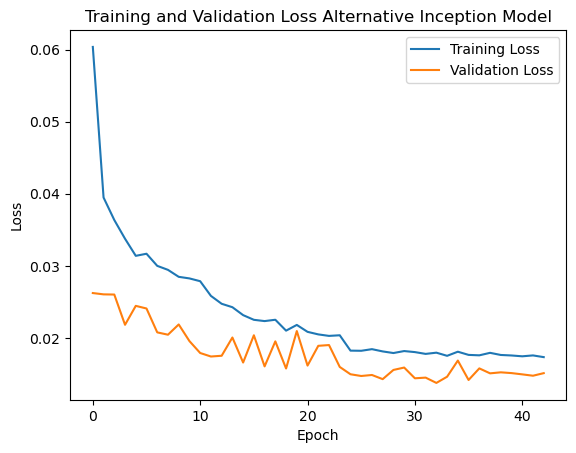

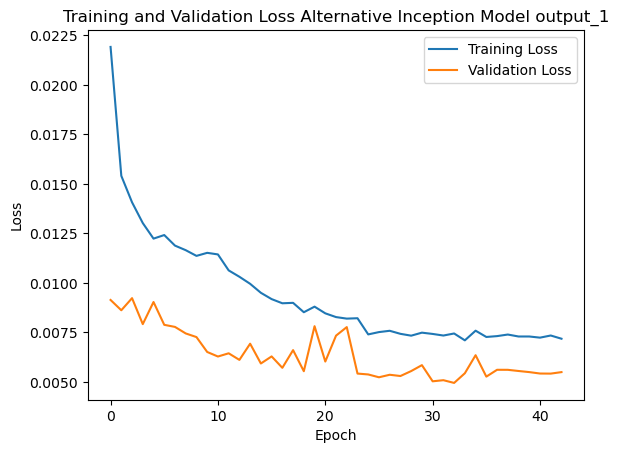

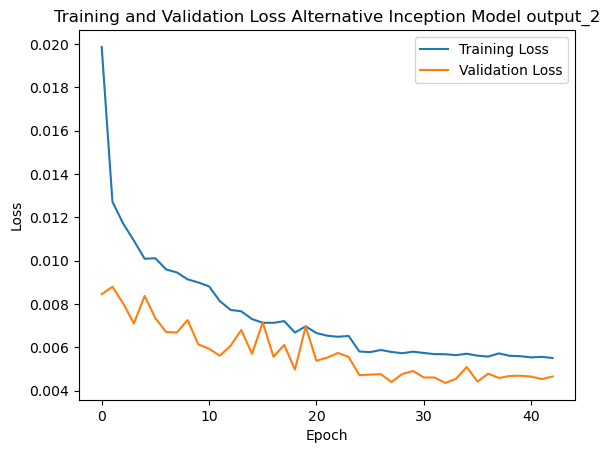

In [26]:
plot_history(history, "Alternative Inception Model", inception_outputs=["output_1", "output_2"])

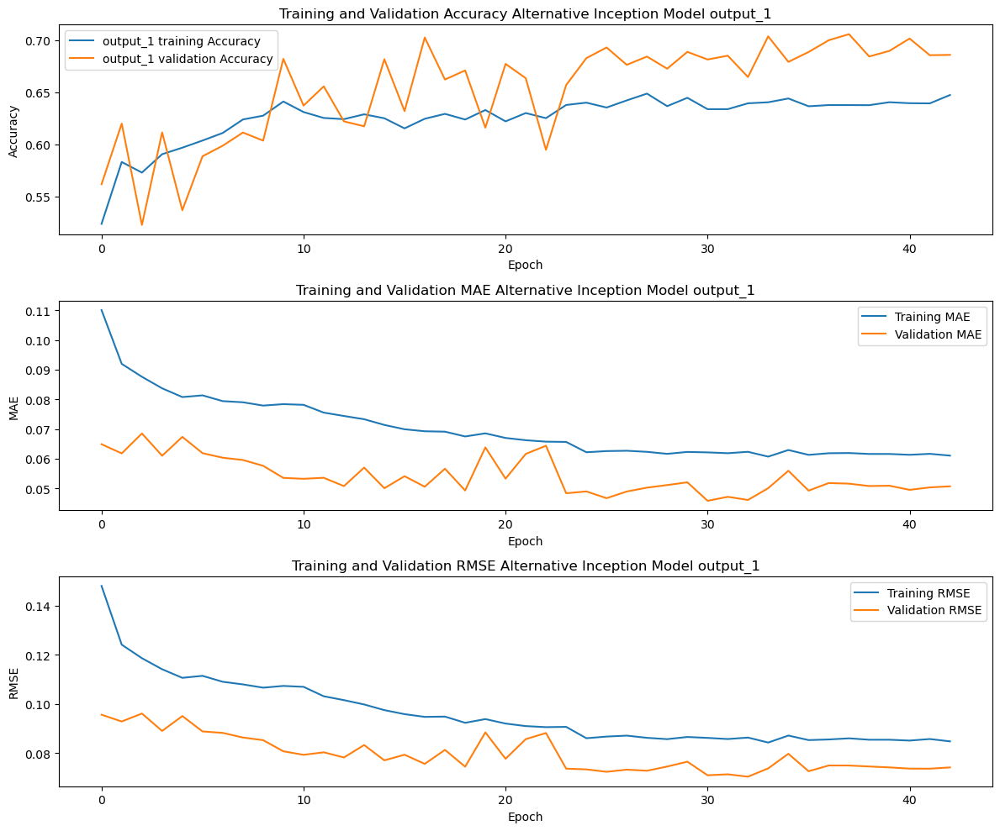

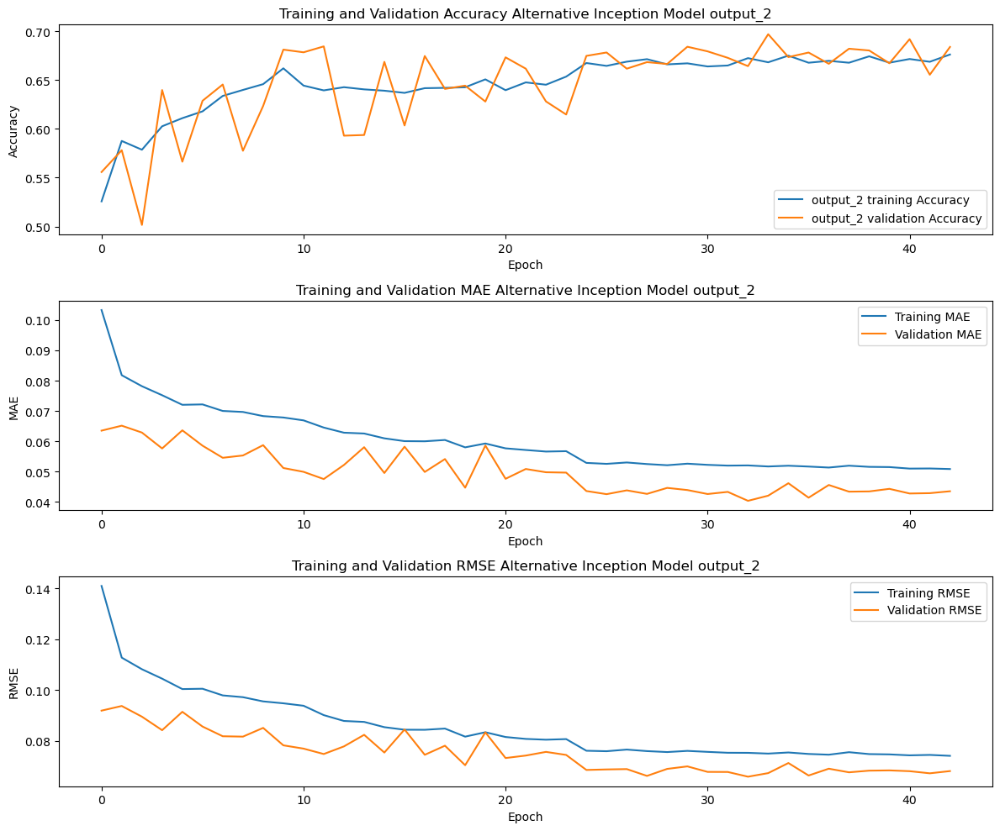

In [27]:
plot_metrics(history, "Alternative Inception Model", inception_outputs=["output_1", "output_2"])

#### Predictions for Training set

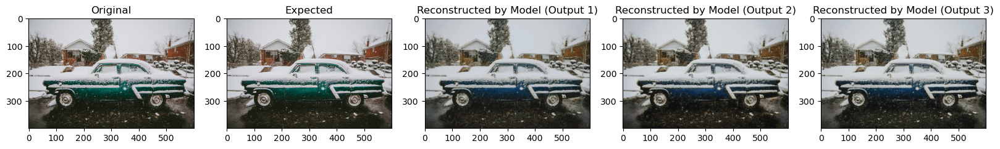

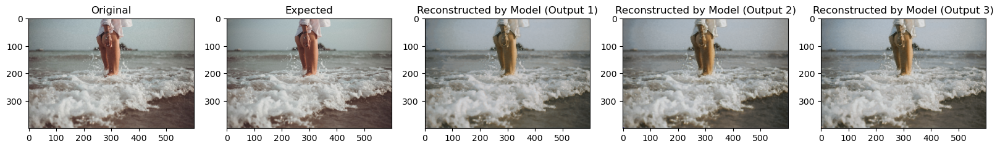

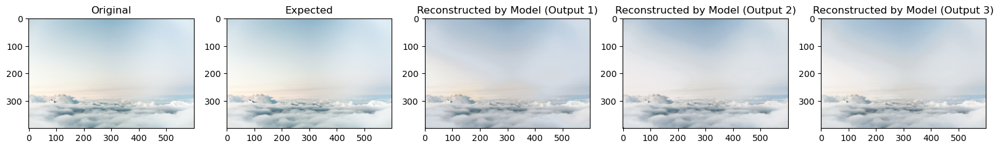

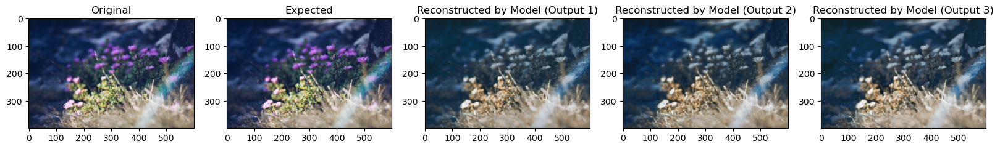

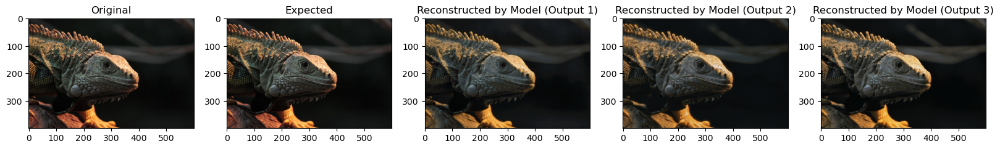

In [28]:
plot_predictions_many_outputs(inception_alt, train_img_gen, size=(20,4))

#### Predictions for Test set

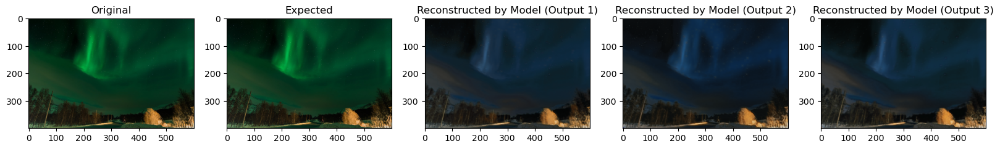

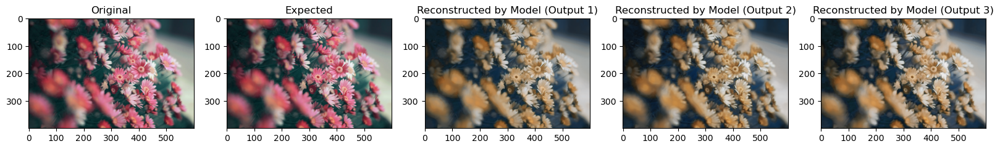

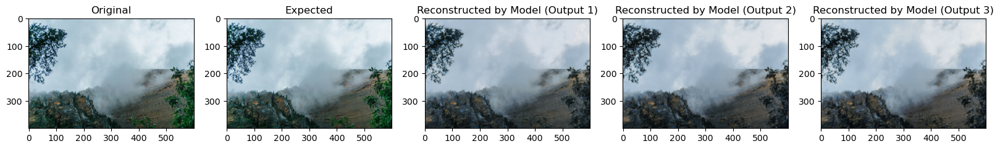

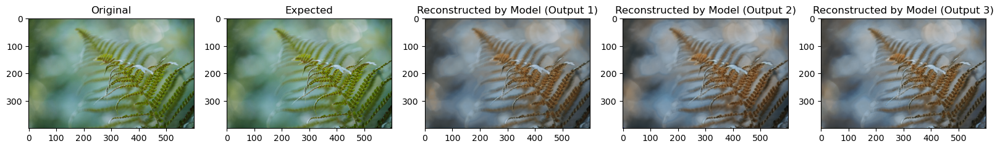

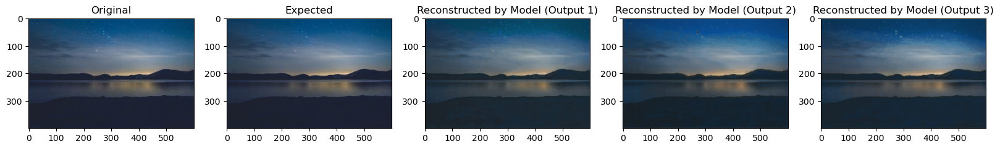

In [29]:
plot_predictions_many_outputs(inception_alt, test_img_gen, size=(20,4))

### Skip-Connection model 1

In [22]:
start_time = time.time()

history = skip_model.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

end_time = time.time()
training_time = end_time - start_time
model_name = "Skip Connections"
time_dict = {model_name: training_time}

Epoch 1/100
376/376 [==============================] - 145s 348ms/step - loss: 0.0078 - accuracy: 0.7655 - mae: 0.0508 - rmse: 0.0885 - val_loss: 0.0037 - val_accuracy: 0.8062 - val_mae: 0.0357 - val_rmse: 0.0607 - lr: 0.0010
Epoch 2/100
376/376 [==============================] - 131s 349ms/step - loss: 0.0030 - accuracy: 0.8481 - mae: 0.0297 - rmse: 0.0544 - val_loss: 0.0031 - val_accuracy: 0.8526 - val_mae: 0.0298 - val_rmse: 0.0556 - lr: 0.0010
Epoch 3/100
376/376 [==============================] - 129s 344ms/step - loss: 0.0027 - accuracy: 0.8658 - mae: 0.0269 - rmse: 0.0518 - val_loss: 0.0032 - val_accuracy: 0.7991 - val_mae: 0.0319 - val_rmse: 0.0566 - lr: 0.0010
Epoch 4/100
376/376 [==============================] - 129s 342ms/step - loss: 0.0028 - accuracy: 0.8478 - mae: 0.0286 - rmse: 0.0525 - val_loss: 0.0040 - val_accuracy: 0.8053 - val_mae: 0.0397 - val_rmse: 0.0633 - lr: 0.0010
Epoch 5/100
376/376 [==============================] - 129s 342ms/step - loss: 0.0026 - accuracy

#### Save model

In [23]:
skip_model.save('models/trained_skip_model.h5')
print(f"Model size: {os.stat('models/trained_skip_model.h5').st_size / 1024} kB")

Model size: 1311.1015625 kB


#### History Plot

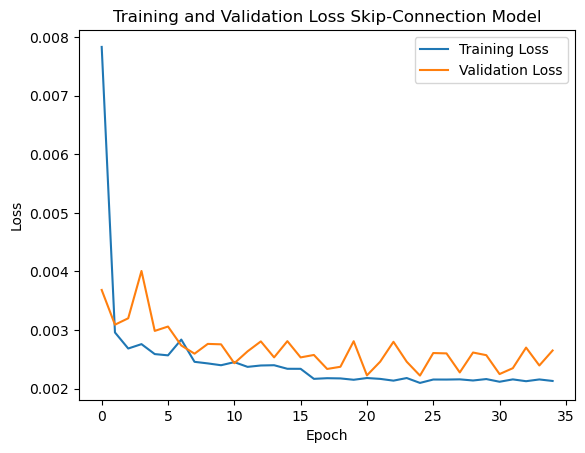

In [24]:
plot_history(history, "Skip-Connection Model")

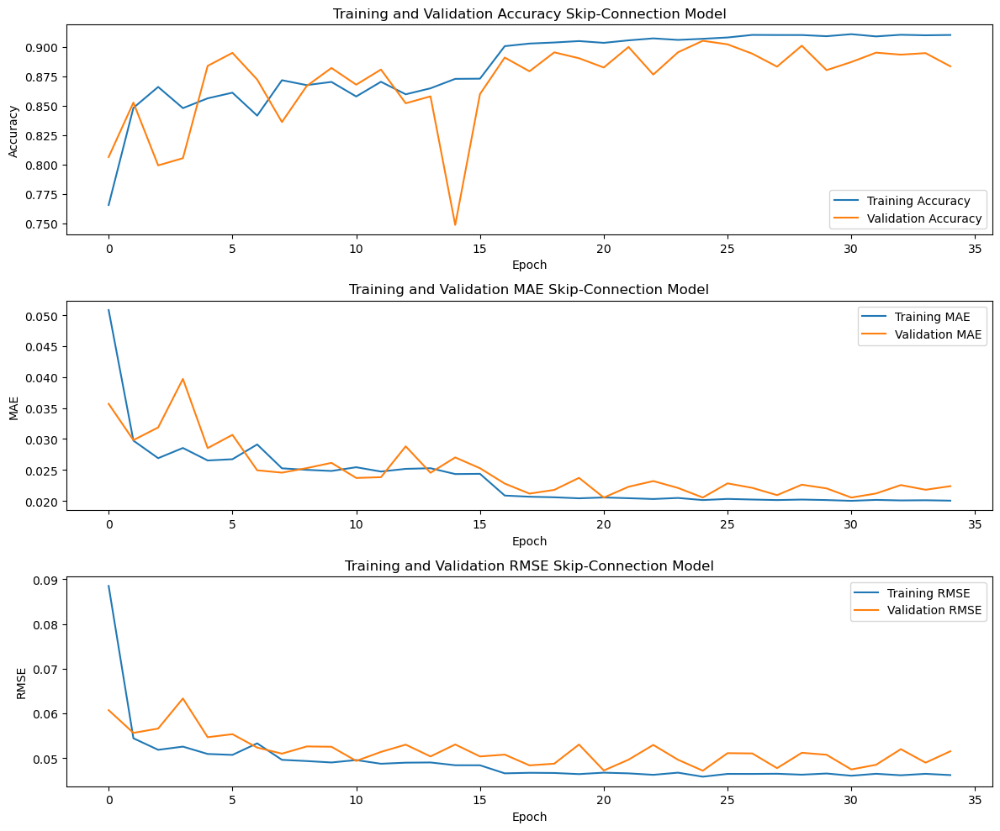

In [25]:
plot_metrics(history, "Skip-Connection Model")

#### Predictions for Training set

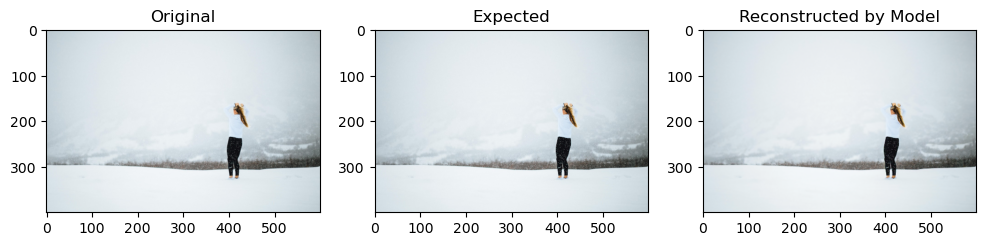

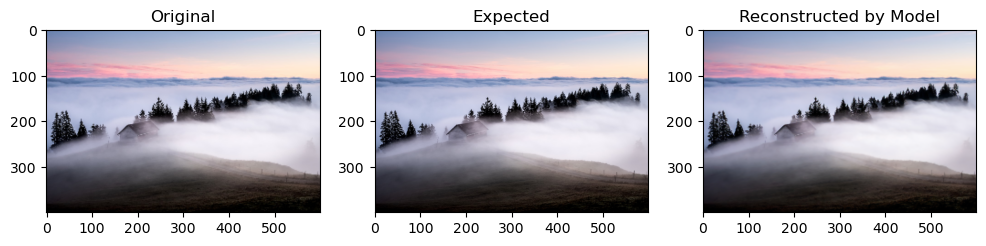

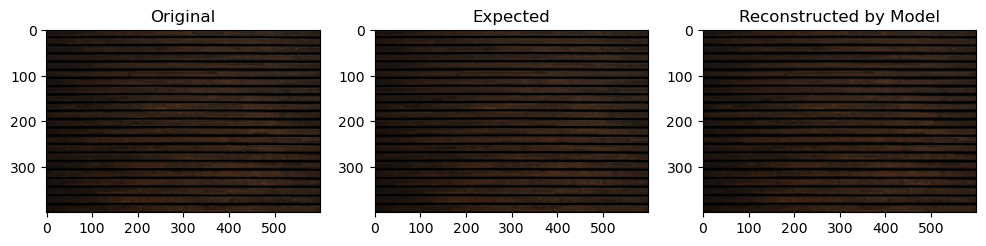

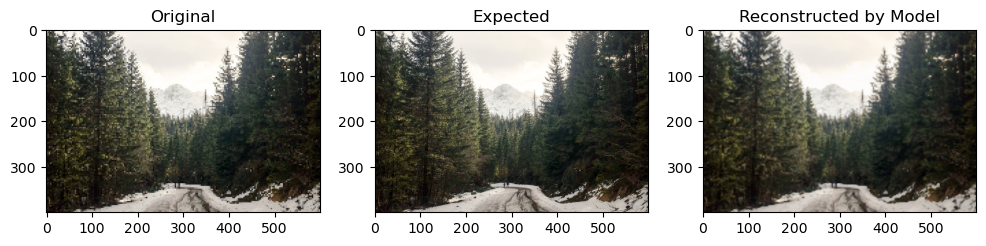

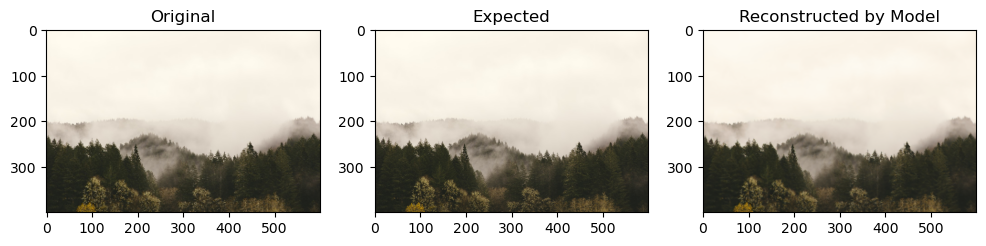

In [26]:
plot_predictions(skip_model, train_img_gen)

#### Predictions for Test set

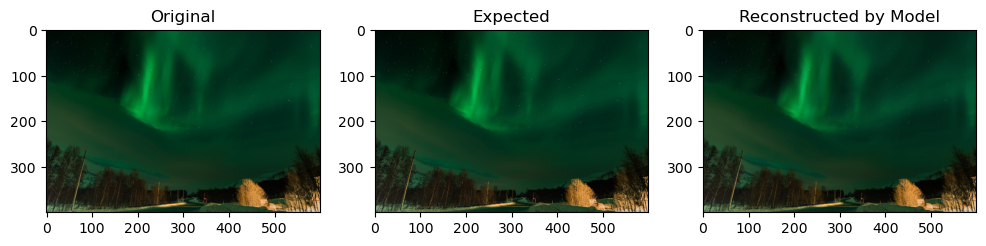

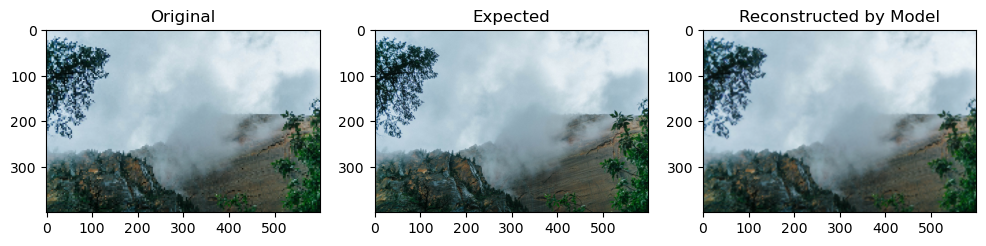

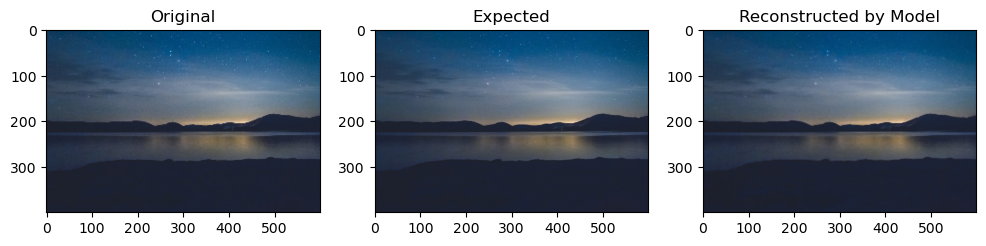

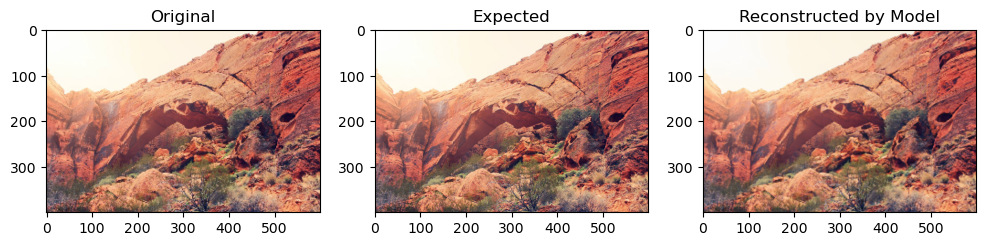

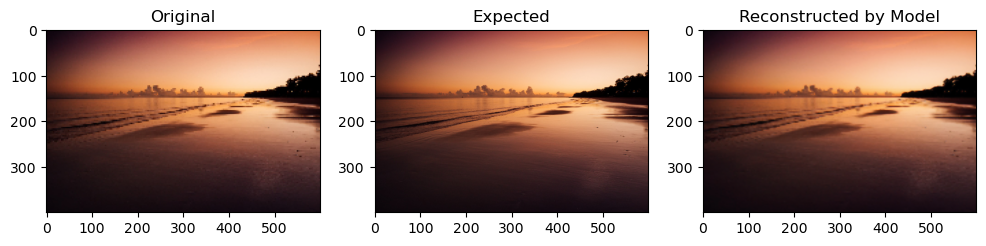

In [27]:
plot_predictions(skip_model, test_img_gen)

### Skip-Connection model 2

In [ ]:
start_time = time.time()

history = skip_model_2.fit(
    train_img_gen,
    epochs=EPOCHS,
    batch_size=BATCH_SIZE,
    steps_per_epoch=train_samples//BATCH_SIZE,
    validation_data = val_img_gen,
    validation_steps=val_samples//BATCH_SIZE,
    callbacks=[early_stopping, reduce_lr_plateau]
)

end_time = time.time()
training_time = end_time - start_time
model_name = "Alternative Skip Connections"
time_dict = {model_name: training_time}

Epoch 1/2
125/125 [==============================] - 74s 458ms/step - loss: 0.0140 - accuracy: 0.6014 - mae: 0.0852 - rmse: 0.1183 - val_loss: 0.0315 - val_accuracy: 0.7168 - val_mae: 0.1549 - val_rmse: 0.1774 - lr: 0.0010
Epoch 2/2
125/125 [==============================] - 64s 464ms/step - loss: 0.0074 - accuracy: 0.6882 - mae: 0.0597 - rmse: 0.0858 - val_loss: 0.0151 - val_accuracy: 0.7513 - val_mae: 0.1021 - val_rmse: 0.1228 - lr: 0.0010


#### Save model

In [ ]:
# skip_model_2.save('models/trained_skip_model_2.h5')
# print(f"Model size: {os.stat('models/trained_skip_model_2.h5').st_size / 1024} kB")

#### History Plot

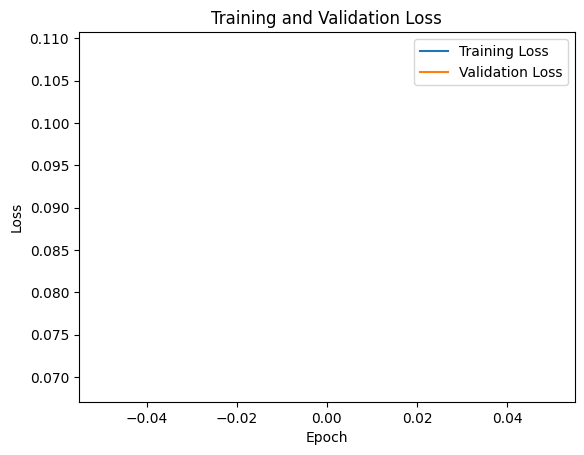

In [ ]:
plot_history(history, "Alternative Skip-Connections")

In [ ]:
plot_metrics(history, "Alternative Skip-Connections")

#### Predictions for Training set

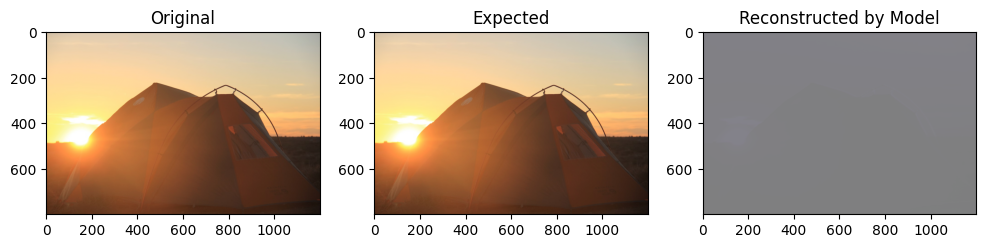

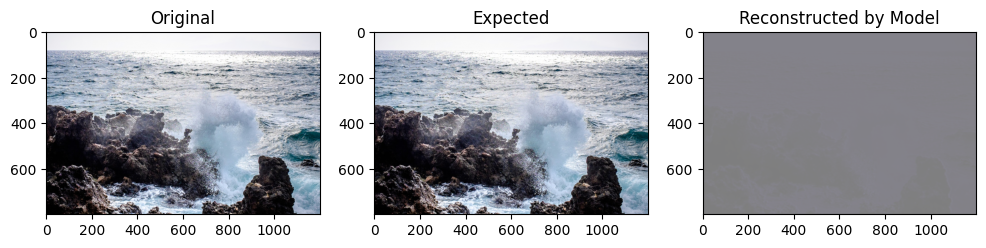

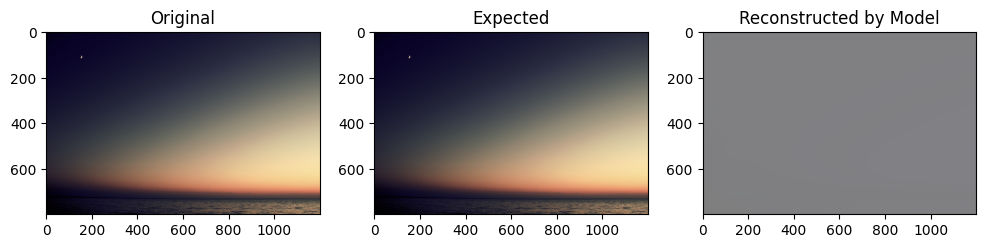

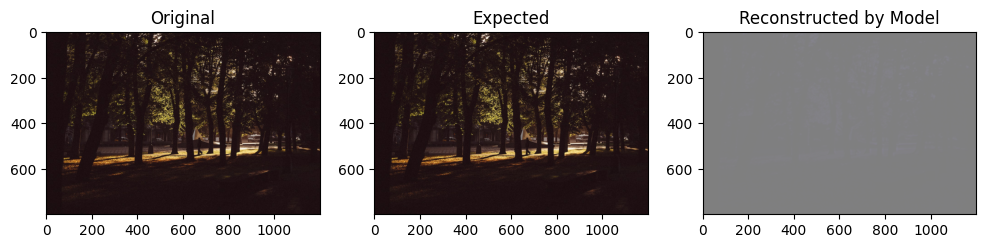

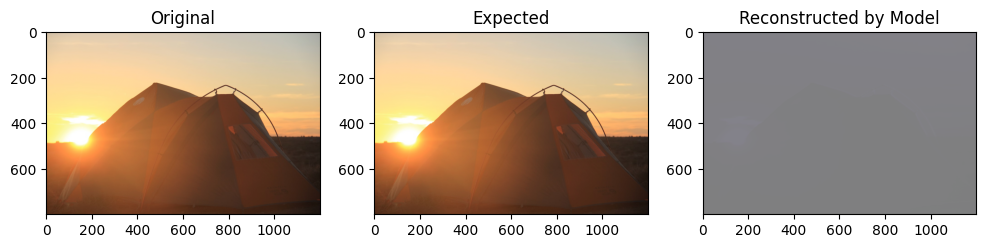

In [ ]:
plot_predictions(skip_model_2, train_img_gen)

#### Predictions for Test set

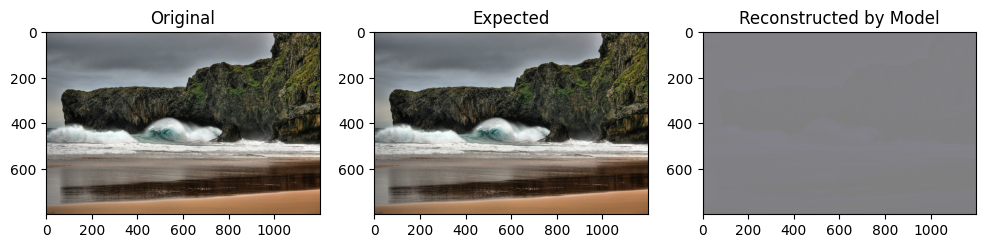

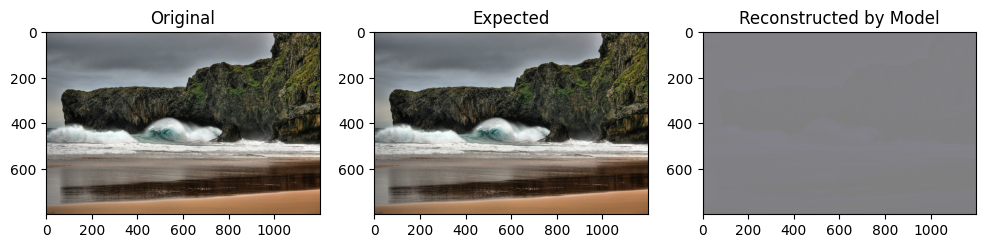

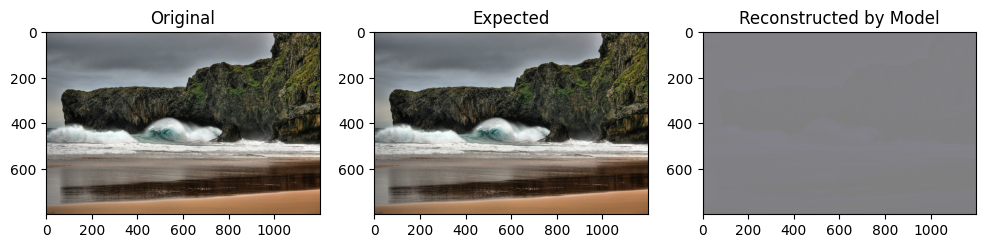

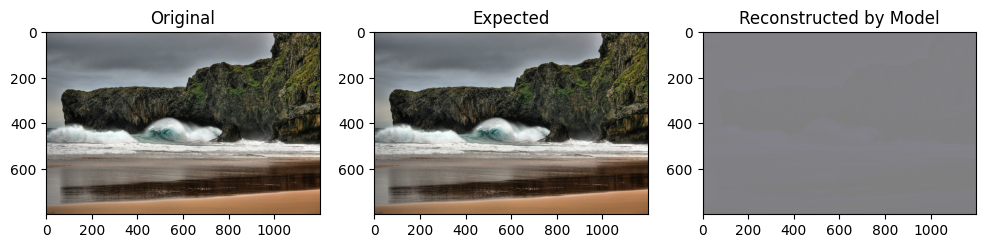

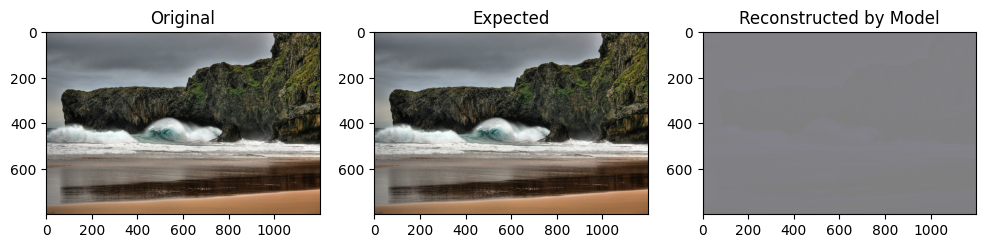

In [ ]:
plot_predictions(skip_model_2, test_img_gen)

### GANs

#### Training

In [ ]:
tf.config.run_functions_eagerly(True)

In [ ]:
best_val_loss = float('inf')
early_stopping_patience = 10
early_stopping_counter = 0

train_gen_losses = []
train_disc_losses = []
avr_train_gen_losses = []
avr_train_disc_losses = []
val_gen_losses = []
val_disc_losses = []

mae_list = []
mse_list = []
accuracy_list = []

@tf.function
def train_step(X, y):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        real_output = discriminator(y, training=True)
        generated_images = generator(X, training=True)
        fake_output = discriminator(generated_images, training=True)
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    train_gen_losses.append(gen_loss)
    train_disc_losses.append(disc_loss)

    try:
        mae_list.append(tf.abs(generated_images - y))
        mse_list.append(tf.square(generated_images - y))
        accuracy_list.append(tf.keras.metrics.binary_accuracy(generated_images, y))
    except:
        pass

start_time = time.time()

for epoch in tqdm(range(EPOCHS), desc="Training Epochs", unit="epoch"):
    for batch_X, batch_y in train_img_gen:
        train_step(batch_X, batch_y)

    val_losses = []
    val_mae = []
    val_mse = []
    val_accuracy = []

    for val_batch_X, val_batch_y in val_img_gen:
        val_real_output = discriminator(val_batch_y, training=False)
        val_generated_images = generator(val_batch_X, training=False)
        val_fake_output = discriminator(val_generated_images, training=False)
        val_gen_loss = generator_loss(val_fake_output)
        val_disc_loss = discriminator_loss(val_real_output, val_fake_output)
        val_losses.append((val_gen_loss, val_disc_loss))

    val_mae.append(np.abs(val_real_output.numpy() - val_fake_output.numpy()))
    val_mse.append(np.square(val_real_output.numpy() - val_fake_output.numpy()))
    val_accuracy.append(tf.keras.metrics.binary_accuracy(val_real_output.numpy(), val_fake_output.numpy()))

    avg_val_gen_loss = tf.reduce_mean([loss[0] for loss in val_losses])
    avg_val_disc_loss = tf.reduce_mean([loss[1] for loss in val_losses])
    avr_train_gen_losses.append(tf.reduce_mean(train_gen_losses))
    avr_train_disc_losses.append(tf.reduce_mean(train_disc_losses))

    mae = tf.reduce_mean(mae_list)
    mse = tf.reduce_mean(mse_list)
    accuracy = tf.reduce_mean(accuracy_list)
    val_gen_losses.append(avg_val_gen_loss)
    val_disc_losses.append(avg_val_disc_loss)

    val_mae = np.array(val_mae)

    print(f"Epoch {epoch + 1}, "
          f"Average Training Generator Loss: {avr_train_gen_losses[-1]}, "
          f"Average Training Discriminator Loss: {avr_train_disc_losses[-1]}, "
          f"Average Validation Generator Loss: {avg_val_gen_loss}, "
          f"Average Validation Discriminator Loss: {avg_val_disc_loss}, "
          f"Average Training MAE: {mae}, "
          f"Average Training MSE: {mse}, "
          f"Average Training Accuracy: {accuracy}"
          f"Average Validation MAE: {tf.reduce_mean(val_mae)}, "
          f"Average Validation MSE: {tf.reduce_mean(val_mse)}, "
          f"Average Validation Accuracy: {tf.reduce_mean(val_accuracy)}",
          )
    
    mae_list = []
    mse_list = []
    accuracy_list = []

    if avg_val_gen_loss < best_val_loss:
        best_val_loss = avg_val_gen_loss
        early_stopping_counter = 0
    else:
        early_stopping_counter += 1

    if early_stopping_counter == early_stopping_patience:
        print(f"Early stopping at epoch {epoch + 1} due to no improvement in validation loss.")
        generator.load_weights('best_generator_weights.h5')
        discriminator.load_weights('best_discriminator_weights.h5')
        break

    train_img_gen.reset()
    val_img_gen.reset()

end_time = time.time()
training_time = end_time - start_time
model_name = "GANs"
time_dict = {model_name: training_time}

print("Finished!")

Training Epochs:   0%|          | 0/2 [00:00<?, ?epoch/s]d:\CV - SuperResolution\super-resolution\lib\site-packages\keras\src\backend.py:5818: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


Epoch 1, Average Training Generator Loss: 0.6407185196876526, Average Training Discriminator Loss: 1.363006591796875, Average Validation Generator Loss: 0.5102807283401489, Average Validation Discriminator Loss: 1.4796584844589233, Average Training MAE: nan, Average Training MSE: nan, Average Training Accuracy: nanAverage Validation MAE: 0.030572593212127686, Average Validation MSE: 0.0009346834267489612, Average Validation Accuracy: 0.0


Training Epochs: 100%|██████████| 2/2 [02:17<00:00, 68.90s/epoch]

Epoch 2, Average Training Generator Loss: 0.580205500125885, Average Training Discriminator Loss: 1.3352251052856445, Average Validation Generator Loss: 0.6148386001586914, Average Validation Discriminator Loss: 1.4055054187774658, Average Training MAE: nan, Average Training MSE: nan, Average Training Accuracy: nanAverage Validation MAE: 0.006745815277099609, Average Validation MSE: 4.550602534436621e-05, Average Validation Accuracy: 0.0
Finished!


#### Save models

In [ ]:
# generator.save('models/trained_generator.h5')
# print(f"Model size: {os.stat('models/trained_generator.h5').st_size / 1024} kB")

In [ ]:
# discriminator.save('models/trained_discriminator.h5')
# print(f"Model size: {os.stat('models/trained_discriminator.h5').st_size / 1024} kB")

#### History Plot

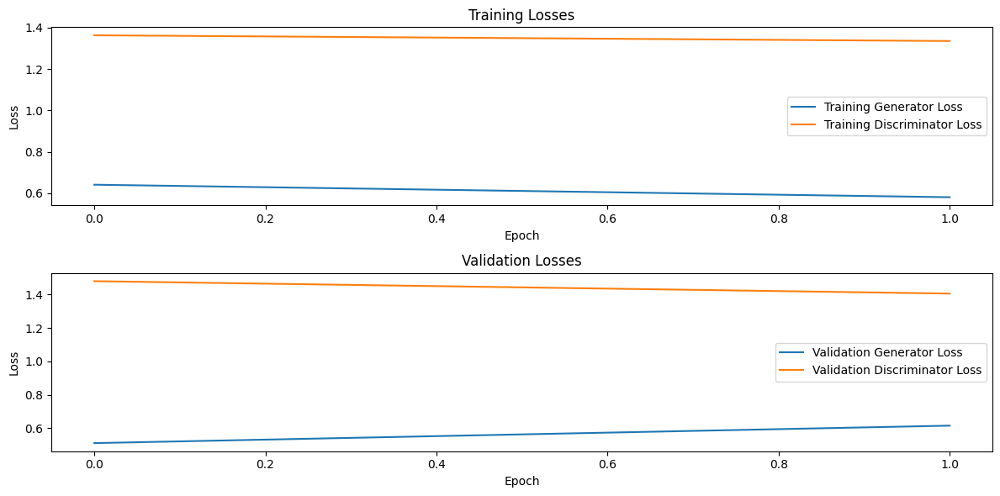

In [ ]:
plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
plt.plot(avr_train_gen_losses, label='Training Generator Loss')
plt.plot(avr_train_disc_losses, label='Training Discriminator Loss')
plt.title('Training Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(2, 1, 2)
plt.plot(val_gen_losses, label='Validation Generator Loss')
plt.plot(val_disc_losses, label='Validation Discriminator Loss')
plt.title('Validation Losses')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()

In [ ]:
model_name = "Generator"

plt.subplot(1, 3, 1)
plt.plot(accuracy_list, label='Training Accuracy')
plt.plot(val_accuracy, label='Validation Accuracy')
plt.title(f'Training and Validation Accuracy {model_name}')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1, 3, 2)
plt.plot(mae_list, label='Training MAE')
plt.plot(val_mae, label='Validation MAE')
plt.title(f'Training and Validation MAE {model_name}')
plt.xlabel('Epoch')
plt.ylabel('MAE')
plt.legend()

plt.subplot(1, 3, 3)
plt.plot(mse_list, label='Training MSE')
plt.plot(val_mae, label='Validation MSE')
plt.title(f'Training and Validation MSE {model_name}')
plt.xlabel('Epoch')
plt.ylabel('RMSE')
plt.legend()

plt.tight_layout()
plt.show()

#### Predictions for Training set

d:\CV - SuperResolution\super-resolution\lib\site-packages\tensorflow\python\data\ops\structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


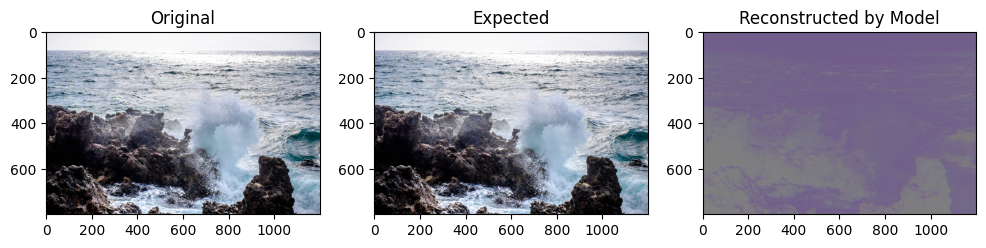

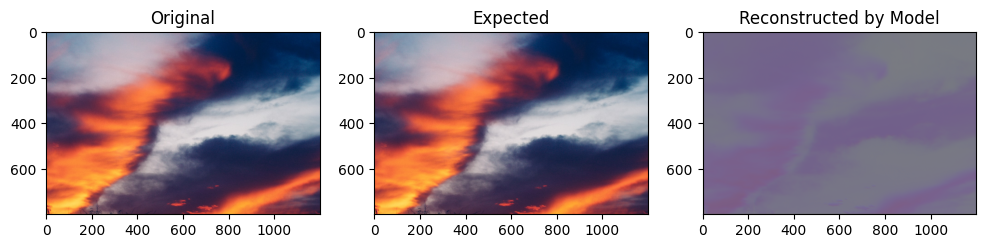

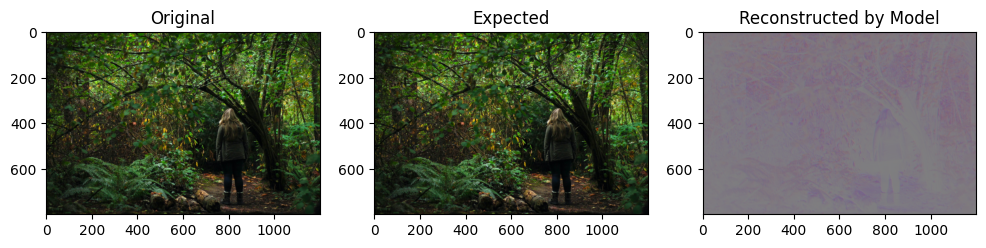

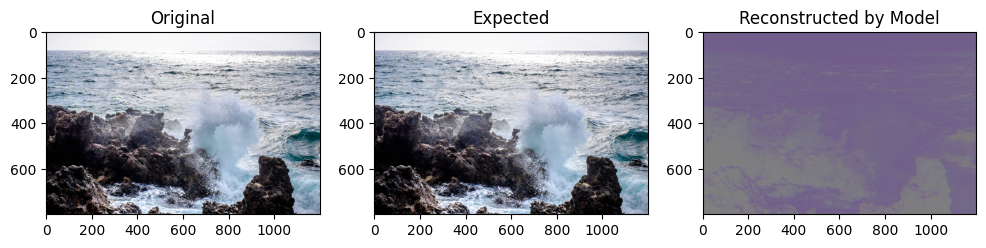

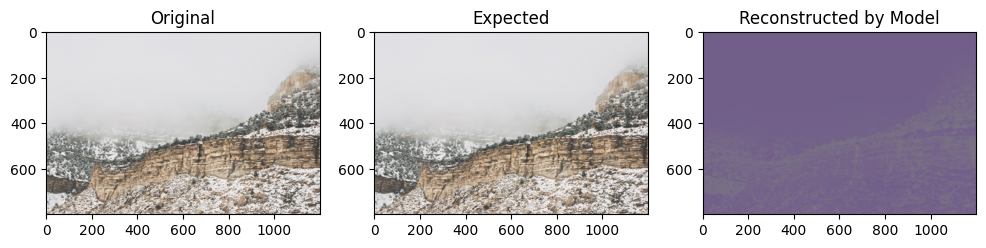

In [ ]:
plot_predictions(generator, train_img_gen)

#### Predictions for Test set

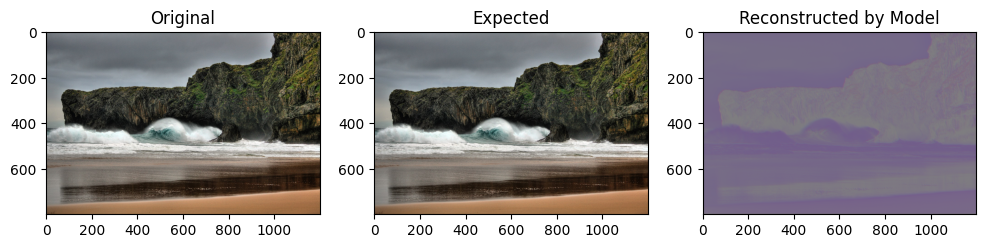

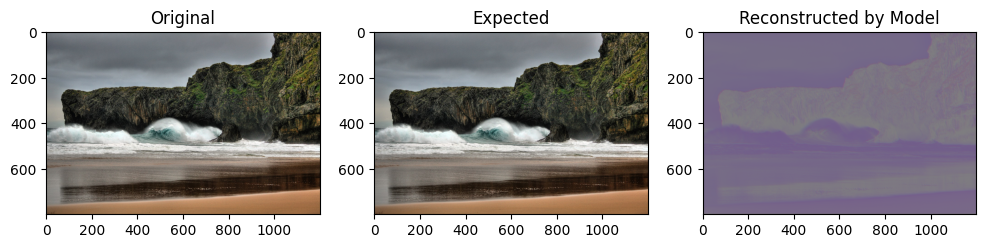

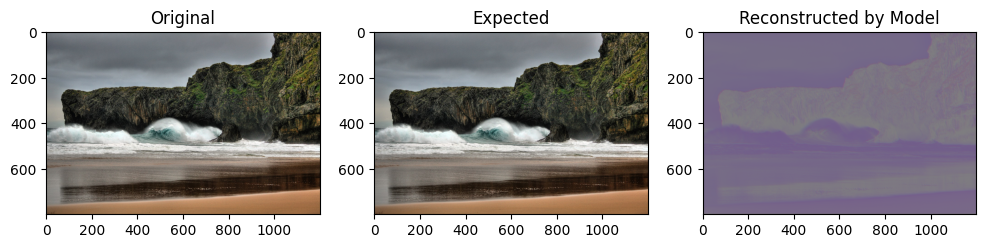

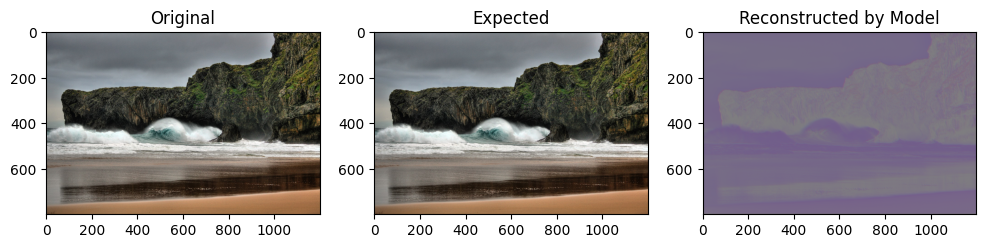

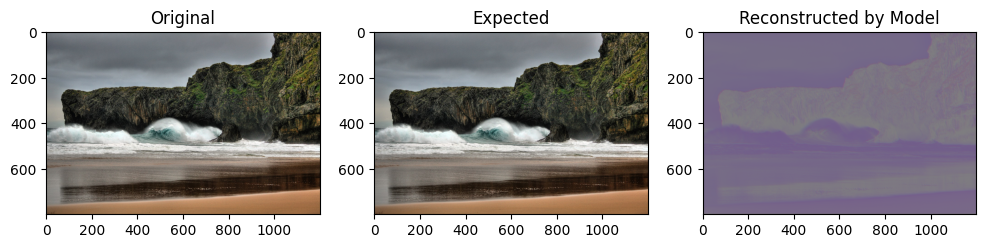

In [ ]:
plot_predictions(generator, val_img_gen)

## Time Comparison

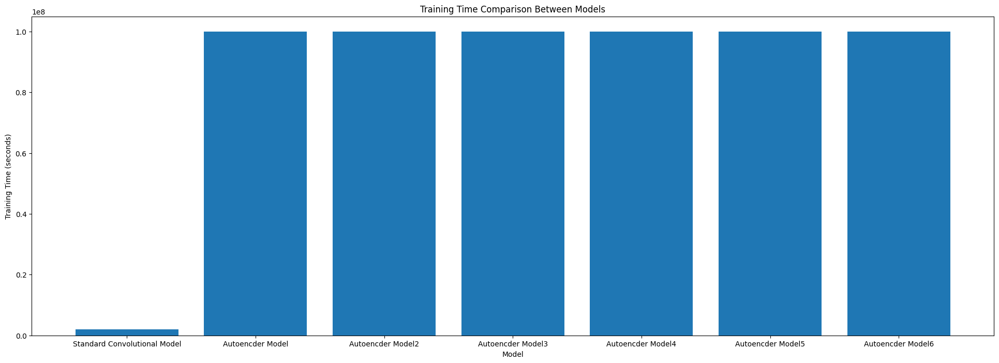

In [ ]:
model_names = list(time_dict.keys())
training_times = list(time_dict.values())

plt.figure(figsize=(24, 8)) 
plt.bar(model_names, training_times)
plt.xlabel('Model')
plt.ylabel('Training Time (seconds)')
plt.title('Training Time Comparison Between Models')
plt.show()